## Author: Akash

### SVI-based Variables & Indices (Boston) 

#### Loading necessary libraries

In [ ]:
# Import libraries
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import geopandas as gpd
import pandas as pd
import numpy as np
from functools import reduce
import contextily as ctx
import datetime as dt
import math
import plotly.express as px
from scipy.stats import spearmanr

#Importing spatial libraries
import fiona.crs
from libpysal.weights.contiguity import Queen
from libpysal import examples
from libpysal import weights
import esda
from esda.moran import Moran, Moran_Local,Moran_BV, Moran_Local_BV
from splot.esda import lisa_cluster, plot_moran_bv_simulation, plot_moran_bv, plot_local_autocorrelation, moran_scatterplot

#### Loading Datasets

In [ ]:
df_zip = pd.read_csv('/work/COVIDRedlining/data/ACS/acs_zip_codes_2018_5yr.csv')

In [ ]:
df_zip['geo_id'].nunique()

33120

In [ ]:
# Read ACS data
df_full = pd.read_csv('/work/COVIDRedlining/data/ACS/ACS Census Tract 2018 (5 years).csv')
df_full.head()

#### Filtering for Boston

In [ ]:
df = df_full[df_full['city_name'] == 'Boston']

In [ ]:
df_redline = gpd.read_file('/work/COVIDRedlining/data/boston/boston_redlined_numerical_values.geojson')

In [ ]:
df_redline.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'GEOID', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON',
       'reweighted_redline_index', 'ordinal_value', 'geometry'],
      dtype='object')

In [ ]:
df_redline = df_redline[['GEOID','reweighted_redline_index', 'ordinal_value']]

In [ ]:
df_redline.rename(columns = {'GEOID':'geo_id'}, inplace=True)

In [ ]:
df = pd.merge(df,
                 df_redline,
                 on='geo_id', 
                 how='left')

In [ ]:
df.columns.tolist()

['geo_id',
 'city_name',
 'redline_index',
 'do_date',
 'total_pop',
 'households',
 'male_pop',
 'female_pop',
 'median_age',
 'male_under_5',
 'male_5_to_9',
 'male_10_to_14',
 'male_15_to_17',
 'male_18_to_19',
 'male_20',
 'male_21',
 'male_22_to_24',
 'male_25_to_29',
 'male_30_to_34',
 'male_35_to_39',
 'male_40_to_44',
 'male_45_to_49',
 'male_50_to_54',
 'male_55_to_59',
 'male_60_to_61',
 'male_62_to_64',
 'male_65_to_66',
 'male_67_to_69',
 'male_70_to_74',
 'male_75_to_79',
 'male_80_to_84',
 'male_85_and_over',
 'female_under_5',
 'female_5_to_9',
 'female_10_to_14',
 'female_15_to_17',
 'female_18_to_19',
 'female_20',
 'female_21',
 'female_22_to_24',
 'female_25_to_29',
 'female_30_to_34',
 'female_35_to_39',
 'female_40_to_44',
 'female_45_to_49',
 'female_50_to_54',
 'female_55_to_59',
 'female_60_to_61',
 'female_62_to_64',
 'female_65_to_66',
 'female_67_to_69',
 'female_70_to_74',
 'female_75_to_79',
 'female_80_to_84',
 'female_85_and_over',
 'white_pop',
 'populat

In [ ]:
#Creating SDH variable percentages

df['less_than_high_school_graduate_perc'] = df['less_than_high_school_graduate'] / df['total_pop']
df['male_pop_perc'] = df['male_pop'] / df['total_pop']
df['management_business_sci_arts_employed_perc'] = df['management_business_sci_arts_employed'] / df['total_pop']
df['children_in_single_female_hh_perc'] = df['children_in_single_female_hh'] / df['households']
df['asian_pop_perc'] = df['asian_pop'] / df['total_pop']
df['no_cars_perc'] = df['no_cars'] / df['households']
df['not_us_citizen_pop_perc'] = df['not_us_citizen_pop'] / df['total_pop']
df['hispanic_pop_perc'] = df['hispanic_pop'] / df['total_pop']
df['aged_65_or_older_perc'] = df['aged_65_or_older'] / df['total_pop']
df['mortgaged_housing_units_perc'] = df['mortgaged_housing_units'] / df['households']
df['households_public_asst_or_food_stamps_perc'] = df['households_public_asst_or_food_stamps'] / df['households']
df['housing_built_1939_or_earlier_perc'] = df['housing_built_1939_or_earlier'] / df['housing_units']
df['multi_unit_structures_perc'] = df['multi_unit_structures'] / df['housing_units']
df['owner_occupied_housing_units_perc'] = df['owner_occupied_housing_units'] / df['housing_units']
df['married_households_perc'] = df['married_households'] / df['households']
df['non_white_perc'] = df['non_white'] / df['total_pop']

In [ ]:
# Define a set variables selected based on SDH, for the purpose of data cleaning

SDH_Vars = ['geo_id','housing_built_1939_or_earlier_perc','no_cars_perc','multi_unit_structures_perc','median_year_structure_built','less_than_high_school_graduate_perc','aged_65_or_older_perc','married_households_perc','households_public_asst_or_food_stamps_perc','management_business_sci_arts_employed_perc','median_age','households','asian_pop_perc','hispanic_pop_perc','bachelors_degree_or_higher_25_64','median_rent','children_in_single_female_hh_perc','mortgaged_housing_units_perc','owner_occupied_housing_units_perc','not_us_citizen_pop_perc','male_pop_perc','non_white_perc','reweighted_redline_index','ordinal_value']

In [ ]:
#Preserve Boston Geodataframe
gdf_Boston = df.copy()
gdf_Boston.head()

,geo_id,city_name,redline_index,do_date,total_pop,households,male_pop,female_pop,median_age,male_under_5,...,not_us_citizen_pop_perc,hispanic_pop_perc,aged_65_or_older_perc,mortgaged_housing_units_perc,households_public_asst_or_food_stamps_perc,housing_built_1939_or_earlier_perc,multi_unit_structures_perc,owner_occupied_housing_units_perc,married_households_perc,non_white_perc
0,2.502506e+10,Boston,100,2014-01-01,4071,2005,2173,1898,31.4,135,...,0.024318,0.025792,0.048145,0.459850,0.042394,0.019499,0.694986,0.483751,0.282793,0.086220
1,2.502506e+10,Boston,100,2014-01-01,2300,1094,914,1386,29.4,68,...,0.111304,0.412609,0.075217,0.007313,0.634369,0.096220,0.849656,0.006873,0.091408,0.822609
2,2.502507e+10,Boston,100,2014-01-01,7075,3493,3534,3541,31.7,158,...,0.214276,0.083816,0.115760,0.198397,0.159748,0.032497,0.979280,0.233152,0.325508,0.474770
3,2.502507e+10,Boston,100,2014-01-01,2398,1136,1157,1241,39.4,0,...,0.198499,0.078816,0.193912,0.036092,0.264085,0.009427,0.971720,0.032207,0.236796,0.701835
4,2.502507e+10,Boston,100,2014-01-01,4290,2185,2095,2195,37.0,94,...,0.126573,0.147786,0.113054,0.329519,0.321739,0.022887,0.938820,0.356954,0.233867,0.521678


In [ ]:
#Subsetting SVI variables
gdf_Boston = gdf_Boston[SDH_Vars]
gdf_Boston.head()

,geo_id,housing_built_1939_or_earlier_perc,no_cars_perc,multi_unit_structures_perc,median_year_structure_built,less_than_high_school_graduate_perc,aged_65_or_older_perc,married_households_perc,households_public_asst_or_food_stamps_perc,management_business_sci_arts_employed_perc,...,bachelors_degree_or_higher_25_64,median_rent,children_in_single_female_hh_perc,mortgaged_housing_units_perc,owner_occupied_housing_units_perc,not_us_citizen_pop_perc,male_pop_perc,non_white_perc,reweighted_redline_index,ordinal_value
0,2.502506e+10,0.019499,0.196509,0.694986,0.0,0.022108,0.048145,0.282793,0.042394,0.509948,...,2591.0,1781.0,0.000000,0.459850,0.483751,0.024318,0.533775,0.086220,3.792748,4
1,2.502506e+10,0.096220,0.625229,0.849656,0.0,0.205652,0.075217,0.091408,0.634369,0.066522,...,246.0,344.0,0.621572,0.007313,0.006873,0.111304,0.397391,0.822609,3.996286,4
2,2.502507e+10,0.032497,0.584025,0.979280,2001.0,0.092721,0.115760,0.325508,0.159748,0.374134,...,3202.0,2074.0,0.005439,0.198397,0.233152,0.214276,0.499505,0.474770,4.000000,4
3,2.502507e+10,0.009427,0.470951,0.971720,1992.0,0.201001,0.193912,0.236796,0.264085,0.236864,...,724.0,849.0,0.102113,0.036092,0.032207,0.198499,0.482485,0.701835,4.000000,4
4,2.502507e+10,0.022887,0.445309,0.938820,0.0,0.096737,0.113054,0.233867,0.321739,0.352214,...,2126.0,NaN,0.051259,0.329519,0.356954,0.126573,0.488345,0.521678,4.000000,4


In [ ]:
#Merging with geo file for spatial analysis

import geopandas as gpd
#Loading MASS geofile
boston_geodf = gpd.read_file('/work/COVIDRedlining/data/boston/boston census tracts/tl_2019_25_tract.shp')

#Taking only geo-values for boston
boston_geoid = list(df_redline['geo_id'])

#Renaming columns 
boston_geodf = boston_geodf.rename(columns={'GEOID':'geo_id'})

#Converting data types
boston_geodf['geo_id'] = boston_geodf['geo_id'].astype(float) 

#Subsetting only boston valyes
boston_geodf = boston_geodf.loc[boston_geodf['geo_id'].isin(boston_geoid)]

#Merging SVI with geo df 
gdf_Boston = boston_geodf.merge(gdf_Boston, on ='geo_id', how ='left')
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,bachelors_degree_or_higher_25_64,median_rent,children_in_single_female_hh_perc,mortgaged_housing_units_perc,owner_occupied_housing_units_perc,not_us_citizen_pop_perc,male_pop_perc,non_white_perc,reweighted_redline_index,ordinal_value
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,1887.0,2629.0,0.039343,0.079183,0.113257,0.160572,0.409539,0.312560,3.904488,4.0
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,1250.0,1236.0,0.158203,0.236328,0.276515,0.116436,0.519347,0.615903,3.725805,4.0
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,1567.0,2578.0,0.000000,0.462192,0.646253,0.016803,0.464244,0.203986,4.000000,4.0
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,463.0,1227.0,0.097955,0.335845,0.400000,0.127273,0.523636,0.663838,3.000000,3.0
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,495.0,413.0,0.426458,0.104874,0.116533,0.153913,0.441739,0.954957,3.000000,3.0


In [ ]:
# Remove duplicates and null values from the SVI-based variables dataset before further processing
gdf_Boston.drop_duplicates(inplace=True)
gdf_Boston.dropna(inplace=True)

In [ ]:
def perc_bin(x):
    
    if x > 0 and x <= 0.1:
      val = 1
    elif x > 0.1 and x <= 0.2:
      val = 2
    elif x > 0.2 and x <= 0.3:
      val = 3
    elif x > 0.3 and x <= 0.4:
      val = 4
    elif x > 0.4 and x <= 0.5:
      val = 5
    elif x > 0.5 and x <= 0.6:
      val = 6
    elif x > 0.6 and x <= 0.7:
      val = 7
    elif x > 0.7 and x <= 0.8:
      val = 8
    elif x > 0.8 and x <= 0.9:
      val = 9
    elif x > 0.9 and x <= 1:
      val = 10
    else:
      val = 0

    return val

In [ ]:
#Making a copy of the Boston data to use for subsetting minority populations later
sdh_boston_minority = gdf_Boston.copy()

#Making a copy of the Boston data to use for creating SDH variables for all census tracts
sdh_boston = gdf_Boston.copy()

#Creating flags as values with 90th/10th percentile

sdh_boston.loc[sdh_boston['less_than_high_school_graduate_perc'] >= sdh_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
sdh_boston['less_than_high_school_graduate_flag'] = sdh_boston['less_than_high_school_graduate_flag'].fillna(0)

#sdh_boston.loc['male_pop_perc'] <= sdh_boston['male_pop_perc'].quantile(0.1), 'male_pop_flag'] = 1
#sdh_boston['male_pop_flag'] = sdh_boston['male_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['management_business_sci_arts_employed_perc'] >= sdh_boston['management_business_sci_arts_employed_perc'].quantile(0.9), 'management_business_sci_arts_employed_flag'] = 1
sdh_boston['management_business_sci_arts_employed_flag'] = sdh_boston['management_business_sci_arts_employed_flag'].fillna(0)

sdh_boston.loc[sdh_boston['children_in_single_female_hh_perc'] >= sdh_boston['children_in_single_female_hh_perc'].quantile(0.9), 'children_in_single_female_hh_flag'] = 1
sdh_boston['children_in_single_female_hh_flag'] = sdh_boston['children_in_single_female_hh_flag'].fillna(0)

sdh_boston.loc[sdh_boston['asian_pop_perc'] >= sdh_boston['asian_pop_perc'].quantile(0.9), 'asian_pop_flag'] = 1
sdh_boston['asian_pop_flag'] = sdh_boston['asian_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['no_cars_perc'] >= sdh_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
sdh_boston['no_cars_flag'] = sdh_boston['no_cars_flag'].fillna(0)

sdh_boston.loc[sdh_boston['not_us_citizen_pop_perc'] >= sdh_boston['not_us_citizen_pop_perc'].quantile(0.9), 'not_us_citizen_pop_flag'] = 1
sdh_boston['not_us_citizen_pop_flag'] = sdh_boston['not_us_citizen_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['hispanic_pop_perc'] >= sdh_boston['hispanic_pop_perc'].quantile(0.9), 'hispanic_pop_flag'] = 1
sdh_boston['hispanic_pop_flag'] = sdh_boston['hispanic_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['aged_65_or_older_perc'] >= sdh_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
sdh_boston['aged_65_or_older_flag'] = sdh_boston['aged_65_or_older_flag'].fillna(0)

sdh_boston.loc[sdh_boston['mortgaged_housing_units_perc'] >= sdh_boston['mortgaged_housing_units_perc'].quantile(0.9), 'mortgaged_housing_units_flag'] = 1
sdh_boston['mortgaged_housing_units_flag'] = sdh_boston['mortgaged_housing_units_flag'].fillna(0)

sdh_boston.loc[sdh_boston['households_public_asst_or_food_stamps_perc'] >= sdh_boston['households_public_asst_or_food_stamps_perc'].quantile(0.9), 'households_public_asst_or_food_stamps_flag'] = 1
sdh_boston['households_public_asst_or_food_stamps_flag'] = sdh_boston['households_public_asst_or_food_stamps_flag'].fillna(0)

sdh_boston.loc[sdh_boston['housing_built_1939_or_earlier_perc'] <= sdh_boston['housing_built_1939_or_earlier_perc'].quantile(0.1), 'housing_built_1939_or_earlier_flag'] = 1
sdh_boston['housing_built_1939_or_earlier_flag'] = sdh_boston['housing_built_1939_or_earlier_flag'].fillna(0)

sdh_boston.loc[sdh_boston['multi_unit_structures_perc'] >= sdh_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
sdh_boston['multi_unit_structures_flag'] = sdh_boston['multi_unit_structures_flag'].fillna(0)

sdh_boston.loc[sdh_boston['owner_occupied_housing_units_perc'] <= sdh_boston['owner_occupied_housing_units_perc'].quantile(0.1), 'owner_occupied_housing_units_flag'] = 1
sdh_boston['owner_occupied_housing_units_flag'] = sdh_boston['owner_occupied_housing_units_flag'].fillna(0)

sdh_boston.loc[sdh_boston['married_households_perc'] <= sdh_boston['married_households_perc'].quantile(0.1), 'married_households_flag'] = 1
sdh_boston['married_households_flag'] = sdh_boston['married_households_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_year_structure_built'] >= sdh_boston['median_year_structure_built'].quantile(0.9), 'median_year_structure_built_flag'] = 1
sdh_boston['median_year_structure_built_flag'] = sdh_boston['median_year_structure_built_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_age'] <= sdh_boston['median_age'].quantile(0.1), 'median_age_flag'] = 1
sdh_boston['median_age_flag'] = sdh_boston['median_age_flag'].fillna(0)

sdh_boston.loc[sdh_boston['bachelors_degree_or_higher_25_64'] <= sdh_boston['bachelors_degree_or_higher_25_64'].quantile(0.1), 'bachelors_degree_or_higher_25_64_flag'] = 1
sdh_boston['bachelors_degree_or_higher_25_64_flag'] = sdh_boston['bachelors_degree_or_higher_25_64_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_rent'] <= sdh_boston['median_rent'].quantile(0.1), 'median_rent_flag'] = 1
sdh_boston['median_rent_flag'] = sdh_boston['median_rent_flag'].fillna(0)

In [ ]:
# The number of flags (for each tract), all SVI-based variables
sdh_boston['SDH'] = sdh_boston['less_than_high_school_graduate_flag'] + sdh_boston['management_business_sci_arts_employed_flag'] + sdh_boston['children_in_single_female_hh_flag'] + sdh_boston['asian_pop_flag'] + sdh_boston['no_cars_flag'] + sdh_boston['not_us_citizen_pop_flag'] + sdh_boston['hispanic_pop_flag'] + sdh_boston['aged_65_or_older_flag'] + sdh_boston['mortgaged_housing_units_flag'] + sdh_boston['households_public_asst_or_food_stamps_flag'] + sdh_boston['housing_built_1939_or_earlier_flag'] + sdh_boston['multi_unit_structures_flag'] + sdh_boston['owner_occupied_housing_units_flag'] + sdh_boston['married_households_flag'] + sdh_boston['median_year_structure_built_flag'] + sdh_boston['median_age_flag'] + sdh_boston['bachelors_degree_or_higher_25_64_flag'] + sdh_boston['median_rent_flag']

# The number of flags (for each tract); Theme#1: Socio-Demographic Status
sdh_boston['Sociodemographic'] = sdh_boston['less_than_high_school_graduate_flag'] + sdh_boston['management_business_sci_arts_employed_flag'] + sdh_boston['households_public_asst_or_food_stamps_flag'] + sdh_boston['median_age_flag'] + sdh_boston['bachelors_degree_or_higher_25_64_flag'] + sdh_boston['median_rent_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
sdh_boston['HouseholdComposition'] = sdh_boston['aged_65_or_older_flag'] + sdh_boston['children_in_single_female_hh_flag'] + sdh_boston['married_households_flag'] 

# The number of flags (for each tract); Theme#3: Minority Status & Language
sdh_boston['MinorityStatus'] = sdh_boston['asian_pop_flag'] + sdh_boston['not_us_citizen_pop_flag'] + sdh_boston['hispanic_pop_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
sdh_boston['HousingTransportation'] = sdh_boston['no_cars_flag'] + sdh_boston['mortgaged_housing_units_flag'] + sdh_boston['housing_built_1939_or_earlier_flag'] + sdh_boston['multi_unit_structures_flag'] + sdh_boston['median_year_structure_built_flag']

In [ ]:
gdf_Boston.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'geo_id', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'housing_built_1939_or_earlier_perc', 'no_cars_perc',
       'multi_unit_structures_perc', 'median_year_structure_built',
       'less_than_high_school_graduate_perc', 'aged_65_or_older_perc',
       'married_households_perc', 'households_public_asst_or_food_stamps_perc',
       'management_business_sci_arts_employed_perc', 'median_age',
       'households', 'asian_pop_perc', 'hispanic_pop_perc',
       'bachelors_degree_or_higher_25_64', 'median_rent',
       'children_in_single_female_hh_perc', 'mortgaged_housing_units_perc',
       'owner_occupied_housing_units_perc', 'not_us_citizen_pop_perc',
       'male_pop_perc', 'non_white_perc', 'reweighted_redline_index',
       'ordinal_value'],
      dtype='object')

#### Descriptive statistics for the SDH variables

In [ ]:
sdh_boston[['reweighted_redline_index','SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']].describe()

,reweighted_redline_index,SDH,Sociodemographic,HouseholdComposition,MinorityStatus,HousingTransportation
count,167.000000,167.000000,167.000000,167.000000,167.000000,167.000000
mean,3.321930,1.838323,0.616766,0.305389,0.305389,0.508982
std,0.585837,2.006968,0.923172,0.511466,0.608302,0.813058
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.008586,1.000000,0.000000,0.000000,0.000000,0.000000
75%,4.000000,3.000000,1.000000,1.000000,0.000000,1.000000
max,4.000000,9.000000,4.000000,2.000000,2.000000,4.000000


#### Which tracts have high SDH scores across all themes? 

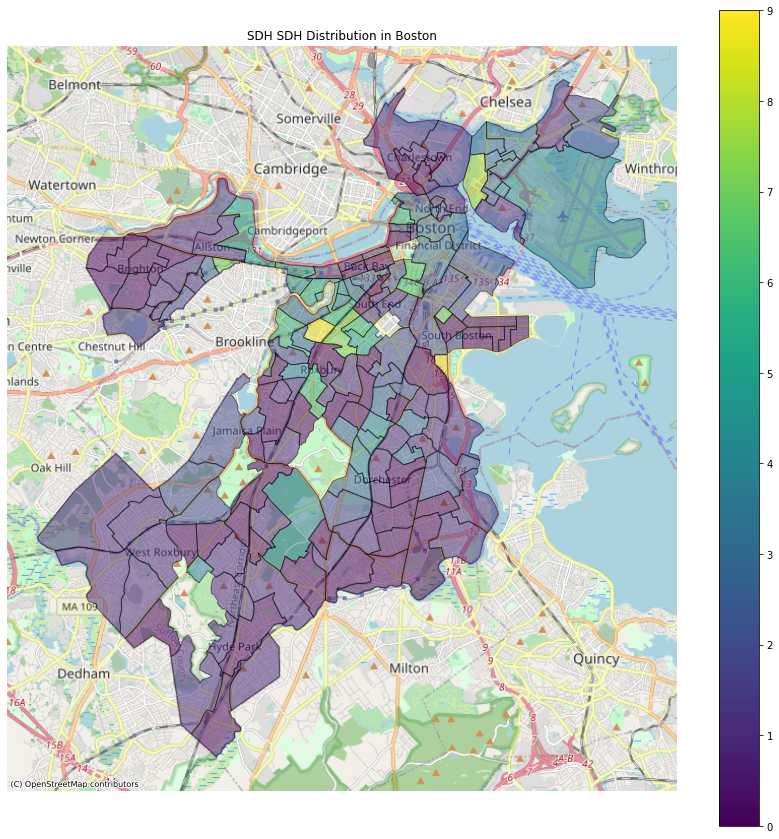

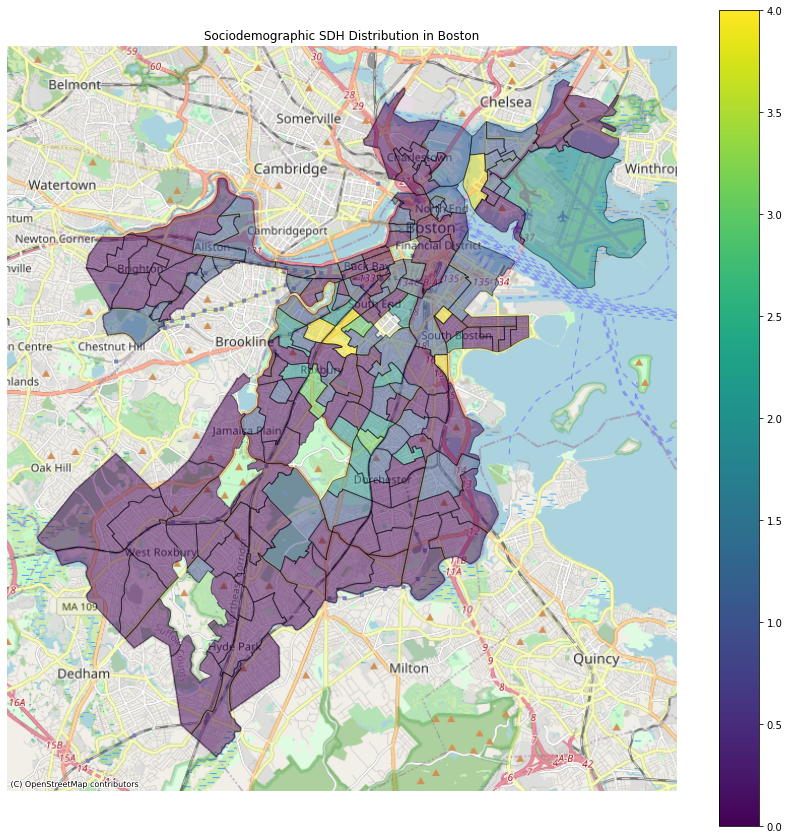

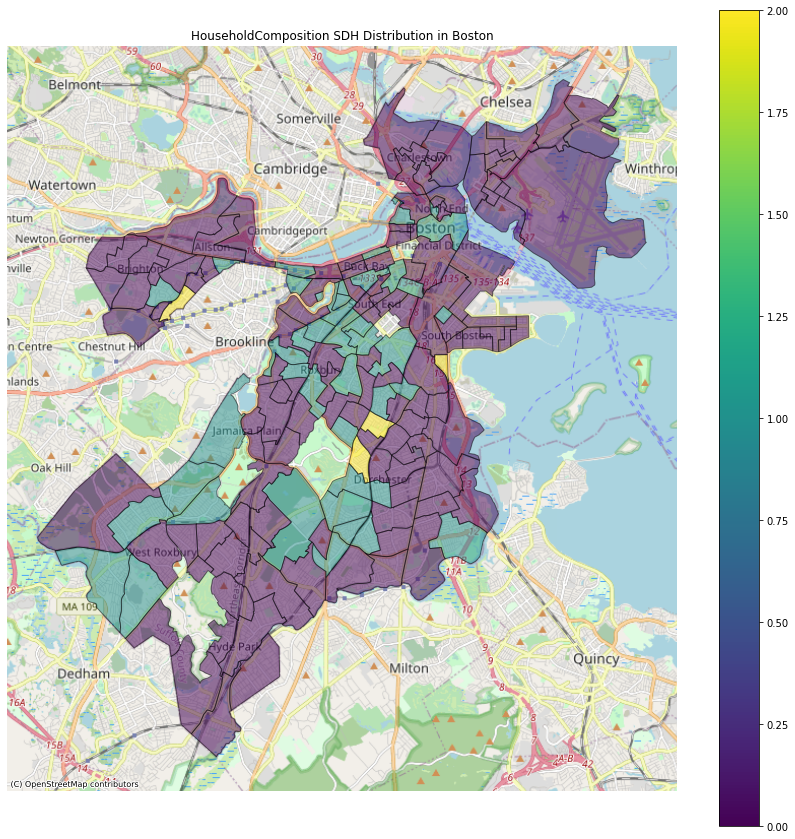

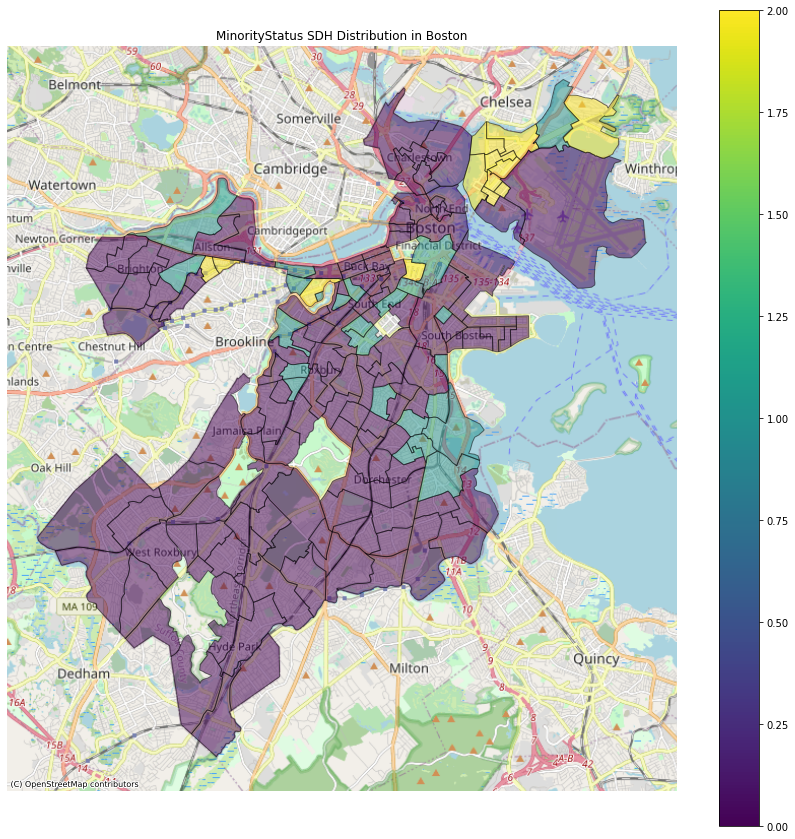

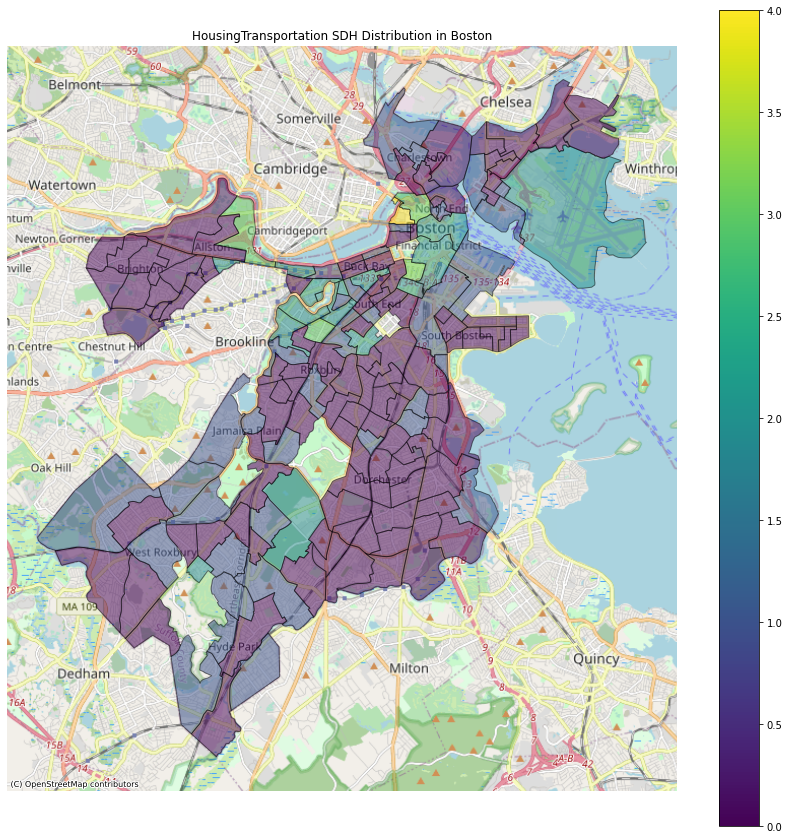

In [ ]:
#Mapping SES SVI Tracts Across Boston

sdhcol = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

for i in sdhcol: 
    ax = sdh_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "viridis",legend=True)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} SDH Distribution in Boston'.format(i))
    ax.set_axis_off()

###  Correlations with reweighted redlining index

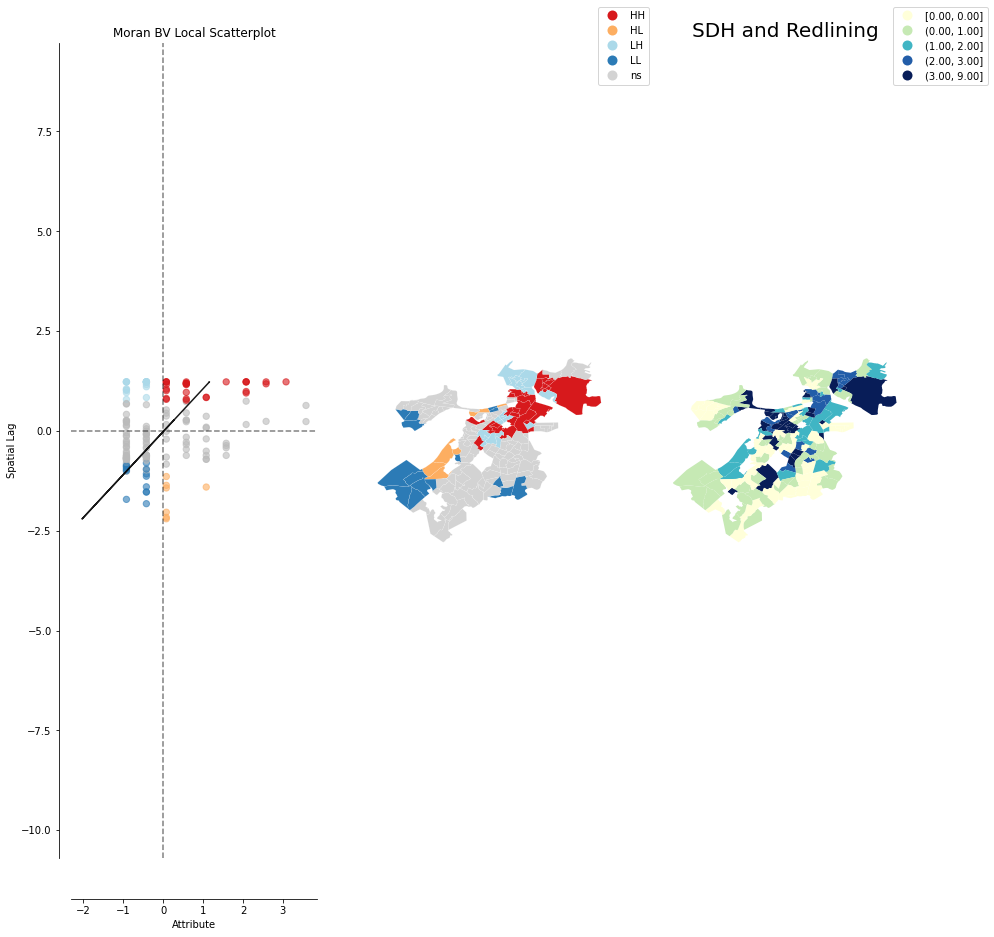

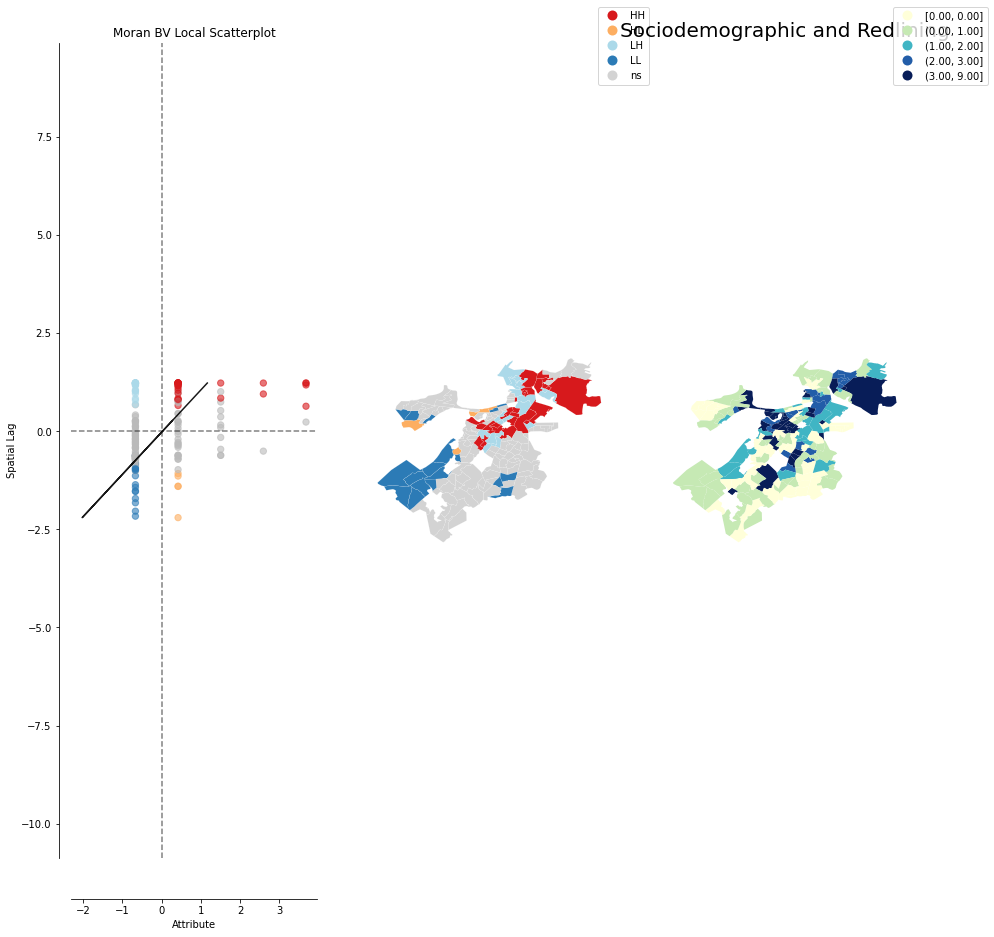

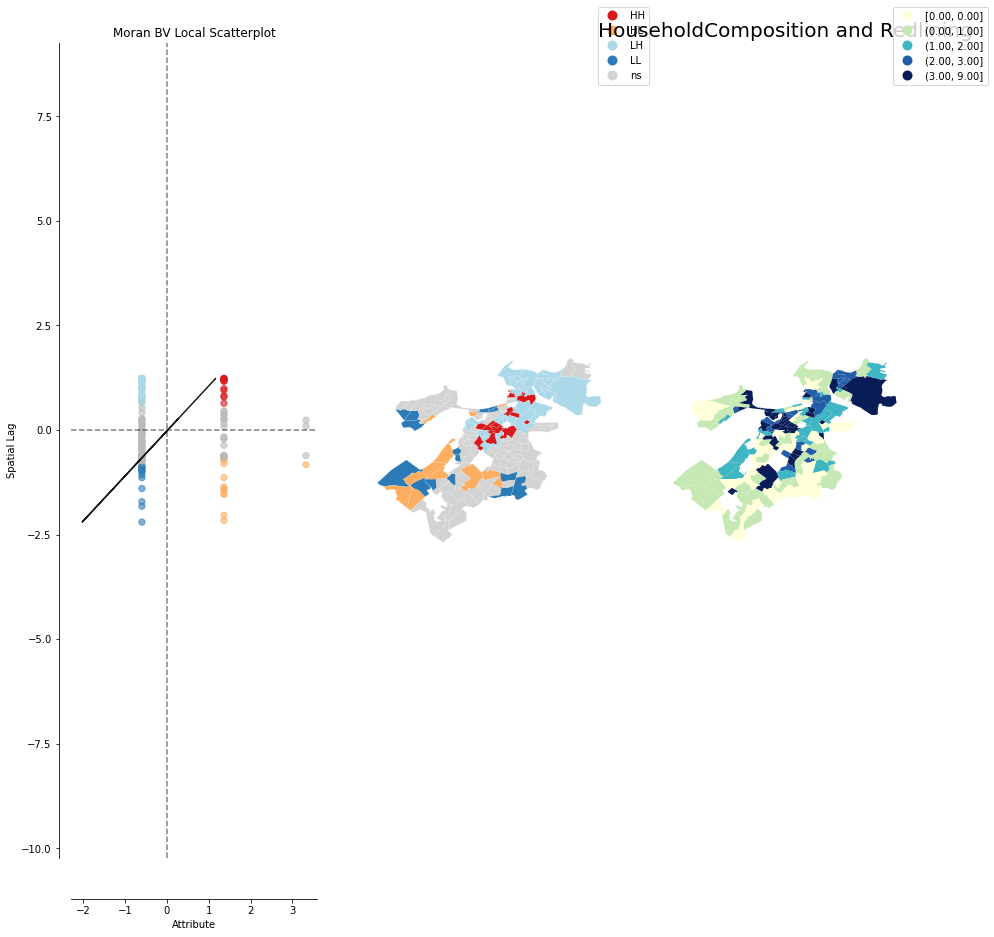

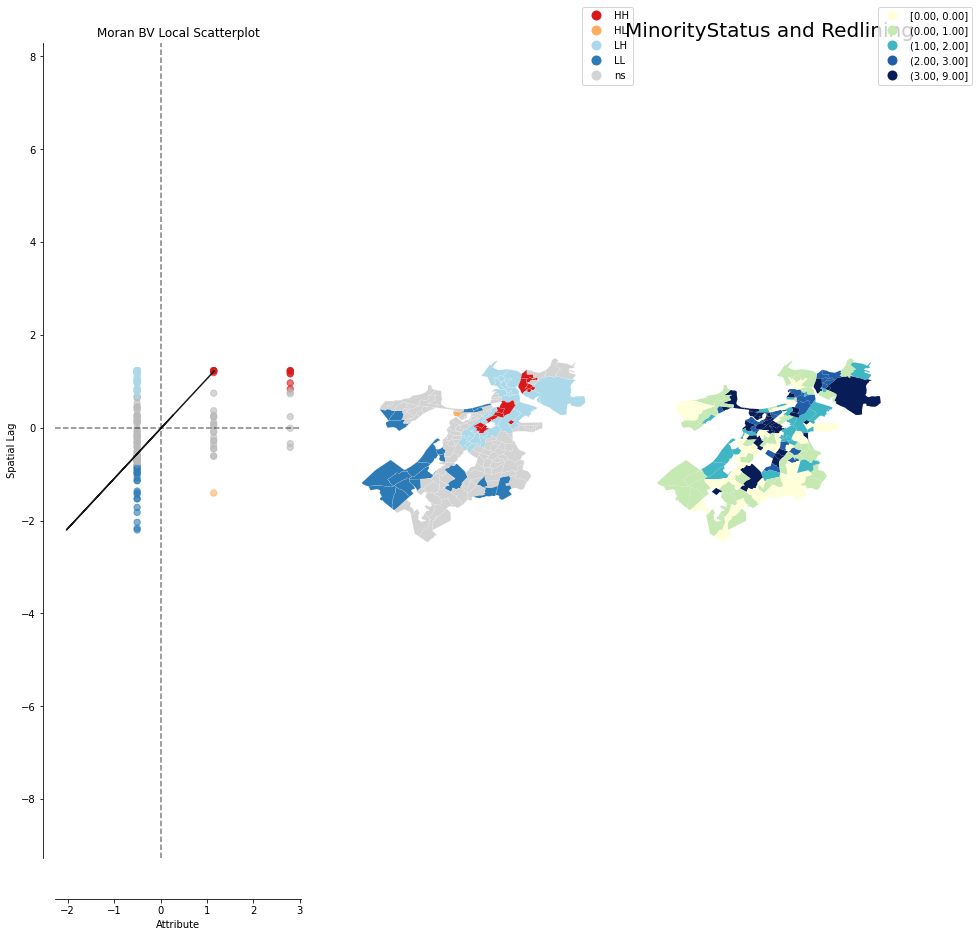

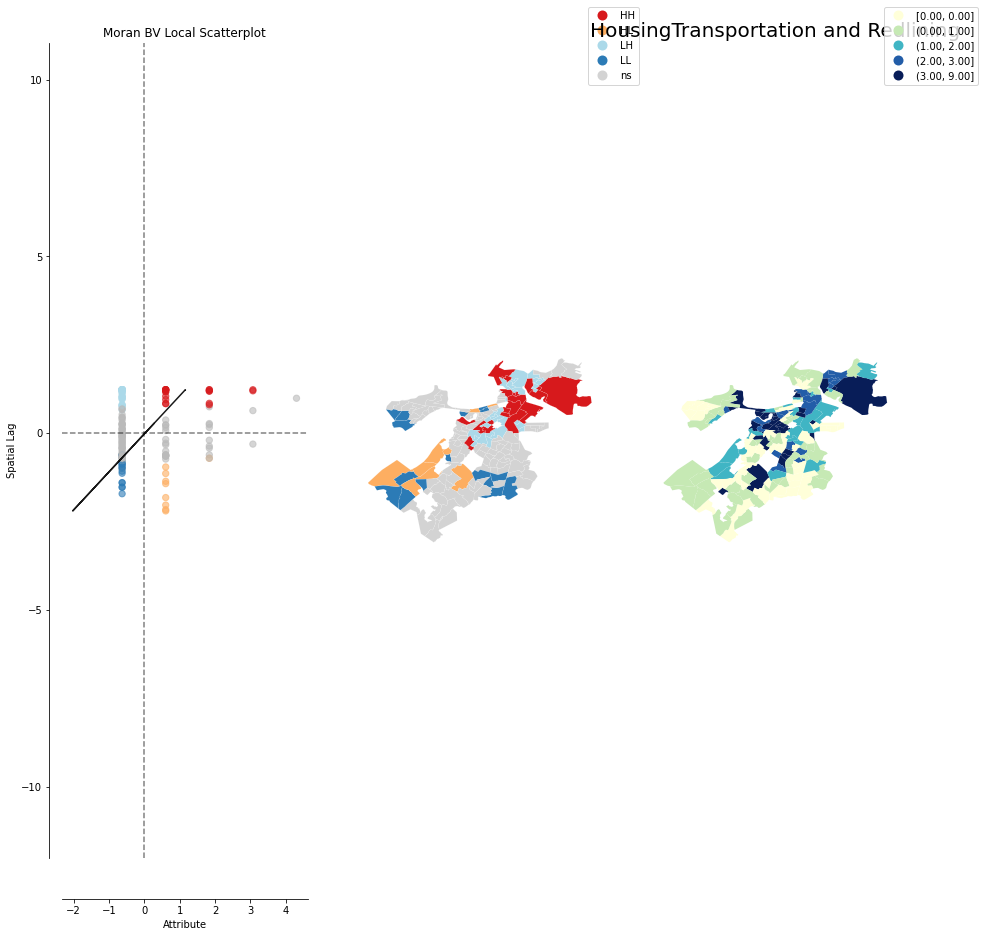

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SDH','Sociodemographic','HouseholdComposition','Minority','HousingTransportation'])

#Dropping null values
sdh_boston = sdh_boston.dropna()

#Renaming columns 
sdh_boston = sdh_boston.rename(columns={'ordinal_value':'redlining_index'})

#Getting all SVI columns
SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

#t = [25025061101.0,25025140106.0,25025060700.0]
#sdh_boston = sdh_boston.loc[~sdh_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(sdh_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SDH_corr_vars:
#Running spatial correlations
    y = sdh_boston[i].values
    x = sdh_boston['reweighted_redline_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    plot_local_autocorrelation(moran_loc_bv, sdh_boston, 'SDH', figsize=(15,15))
    #Adding a column for cluster values
    sdh_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Redlining'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr

,SDH,Sociodemographic,HouseholdComposition,Minority,HousingTransportation
0,0.225799,0.248326,-0.057404,0.203088,0.115263


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
spearman = pd.DataFrame(columns=['SDH','SDH_pval','Sociodemographic','Sociodemographic_pval','HouseholdComposition','HouseholdComposition_pval','MinorityStatus','MinorityStatus_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

for i in SDH_corr_vars:
    
    #Making subset with dropped NA's
    sdh_boston_spearman = sdh_boston.copy()
    sdh_boston_spearman = sdh_boston.dropna()

    spearman_corr =  spearmanr(sdh_boston_spearman['reweighted_redline_index'], sdh_boston_spearman[i])[0]
    p_val = spearmanr(sdh_boston_spearman['reweighted_redline_index'], sdh_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(spearman)
spearman.loc[df_length] = corr_list
spearman

,SDH,SDH_pval,Sociodemographic,Sociodemographic_pval,HouseholdComposition,HouseholdComposition_pval,MinorityStatus,MinorityStatus_pval,HousingTransportation,HousingTransportation_pval
0,0.256576,0.000817,0.272537,0.000366,-0.033786,0.664683,0.237375,0.00201,0.089908,0.247891


In [ ]:
#Reassigning cluster values such that 1 = HH, 2 = HL, 3 = LH, 4 = LL
def cluster_assign(row):

    if row == 2:
        val = 3
    elif row == 3:
        val = 4
    elif row == 4:
        val = 2
    else:
        val = 1

    return val

In [ ]:
#Applying clusters

sdh_boston['SDH_cluster'] = sdh_boston['SDH_cluster'].apply(cluster_assign)
sdh_boston['Sociodemographic_cluster'] = sdh_boston['Sociodemographic_cluster'].apply(cluster_assign)
sdh_boston['HouseholdComposition_cluster'] = sdh_boston['HouseholdComposition_cluster'].apply(cluster_assign)
sdh_boston['MinorityStatus_cluster'] = sdh_boston['MinorityStatus_cluster'].apply(cluster_assign)
sdh_boston['HousingTransportation_cluster'] = sdh_boston['HousingTransportation_cluster'].apply(cluster_assign)

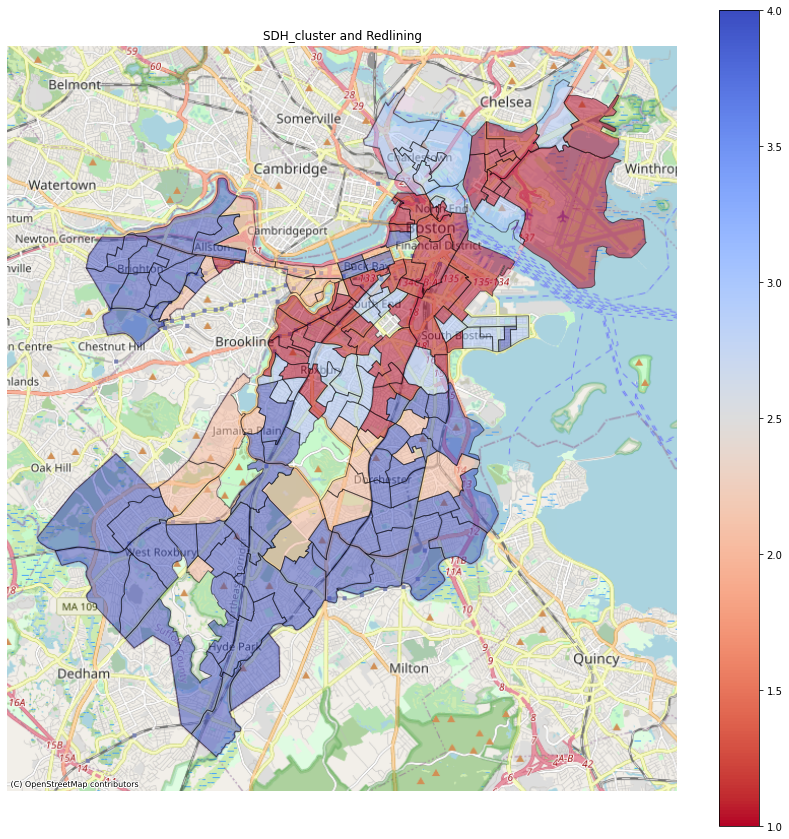

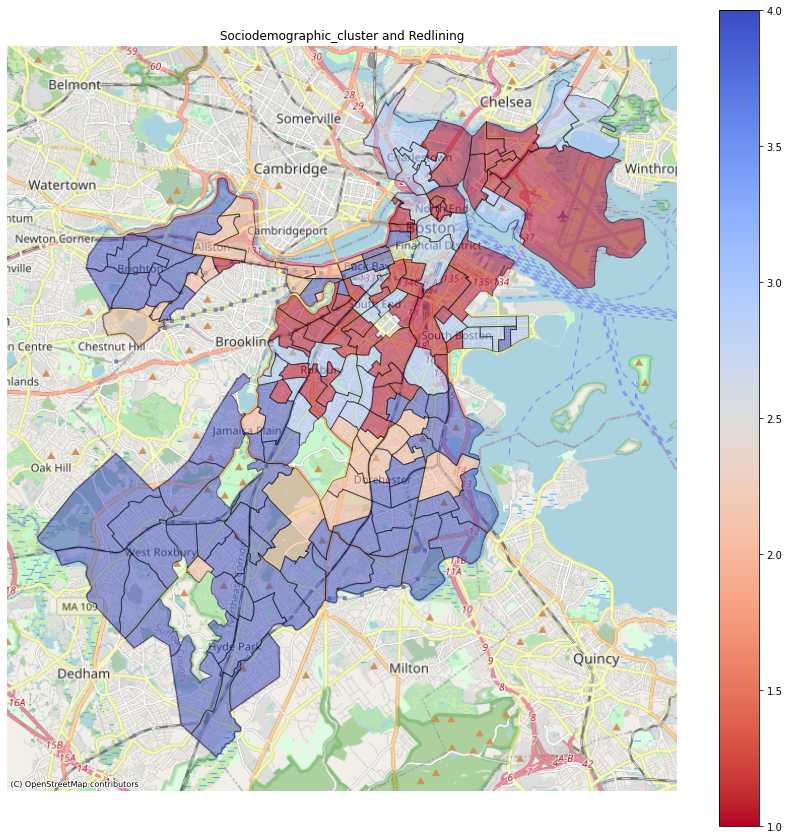

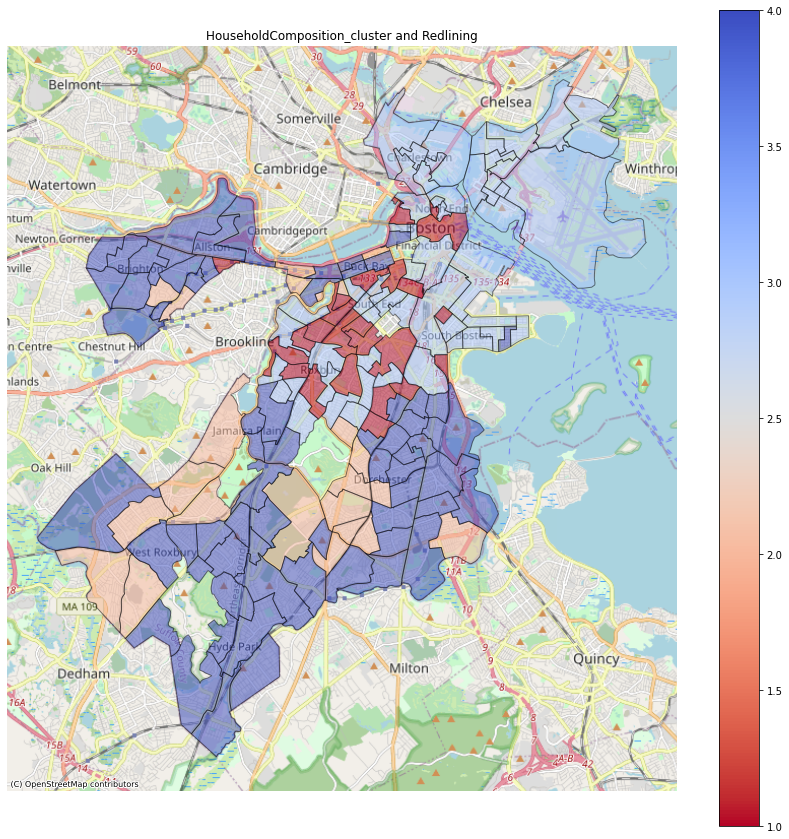

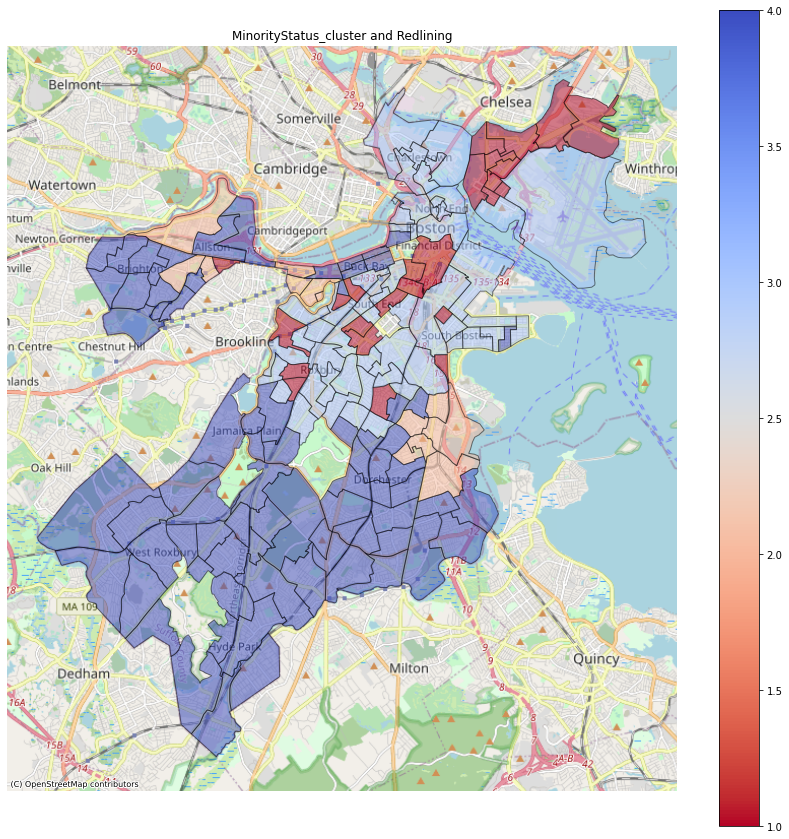

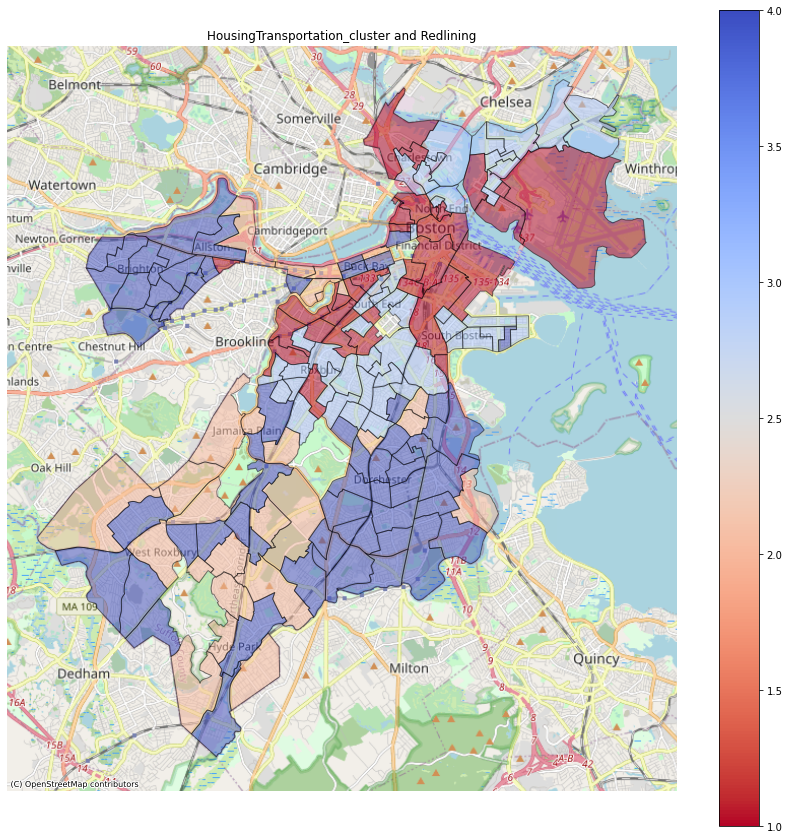

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SDH_cluster','Sociodemographic_cluster','HouseholdComposition_cluster','MinorityStatus_cluster','HousingTransportation_cluster']
for i in cluster_list:
    ax = sdh_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin=1, vmax=4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Redlining'.format(i))
    ax.set_axis_off()

### With minority threshold > 70%

In [ ]:
#### Descriptive statistics for SVI variables where minority threshold defined as >70%

In [ ]:
#Creating flags 

sdh_boston.loc[sdh_boston['non_white_perc'] >= sdh_boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
sdh_boston['non_white_flag'] = sdh_boston['non_white_flag'].fillna(0)
minority_sdh_boston = sdh_boston[sdh_boston['non_white_flag'] == 1]

In [ ]:
minority_sdh_boston[['reweighted_redline_index','SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']].describe()

,reweighted_redline_index,SDH,Sociodemographic,HouseholdComposition,MinorityStatus,HousingTransportation
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000
mean,3.376257,2.100000,0.940000,0.460000,0.380000,0.220000
std,0.490873,2.111678,1.095631,0.613122,0.666701,0.545482
min,2.456926,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.025243,1.500000,1.000000,0.000000,0.000000,0.000000
75%,3.997813,3.000000,1.000000,1.000000,1.000000,0.000000
max,4.000000,9.000000,4.000000,2.000000,2.000000,2.000000


/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)


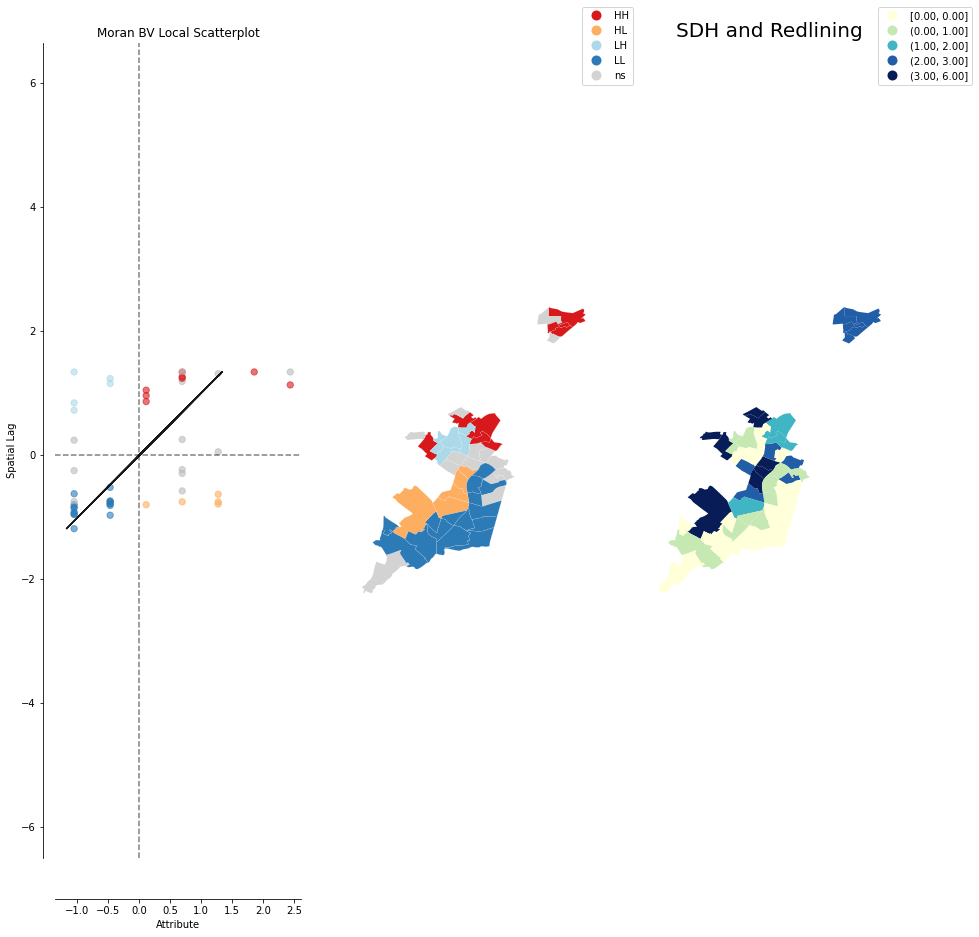

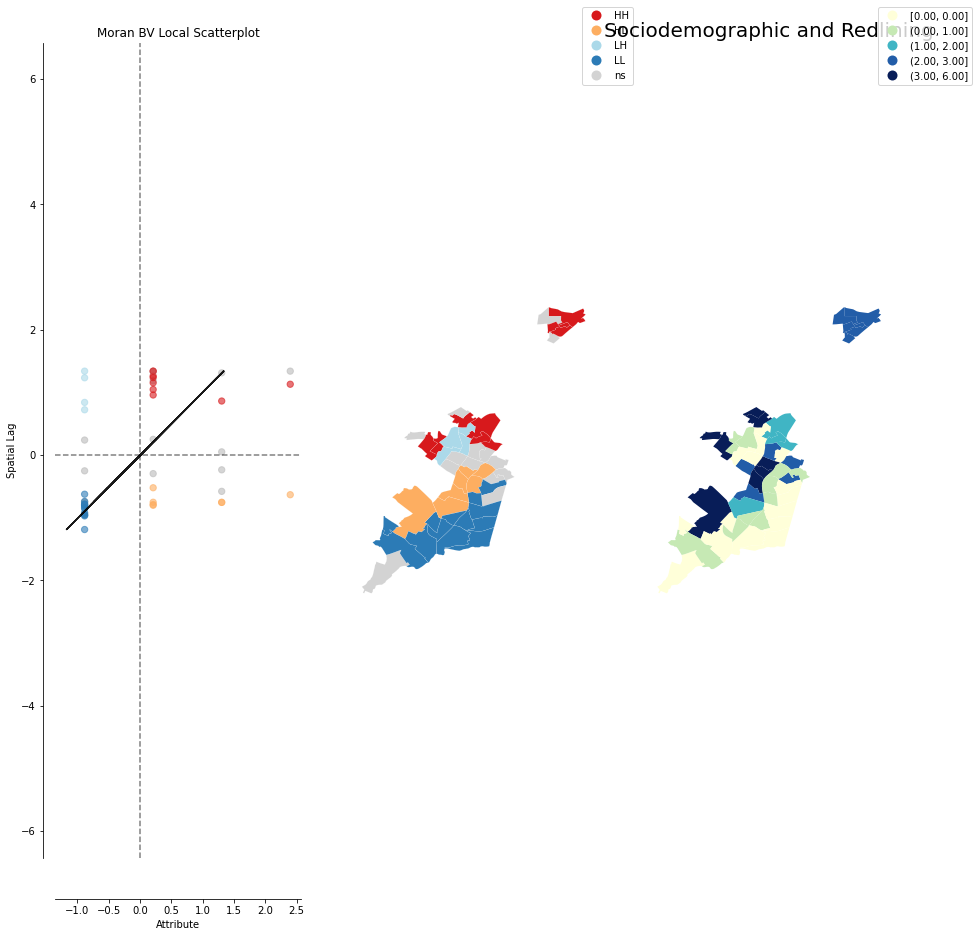

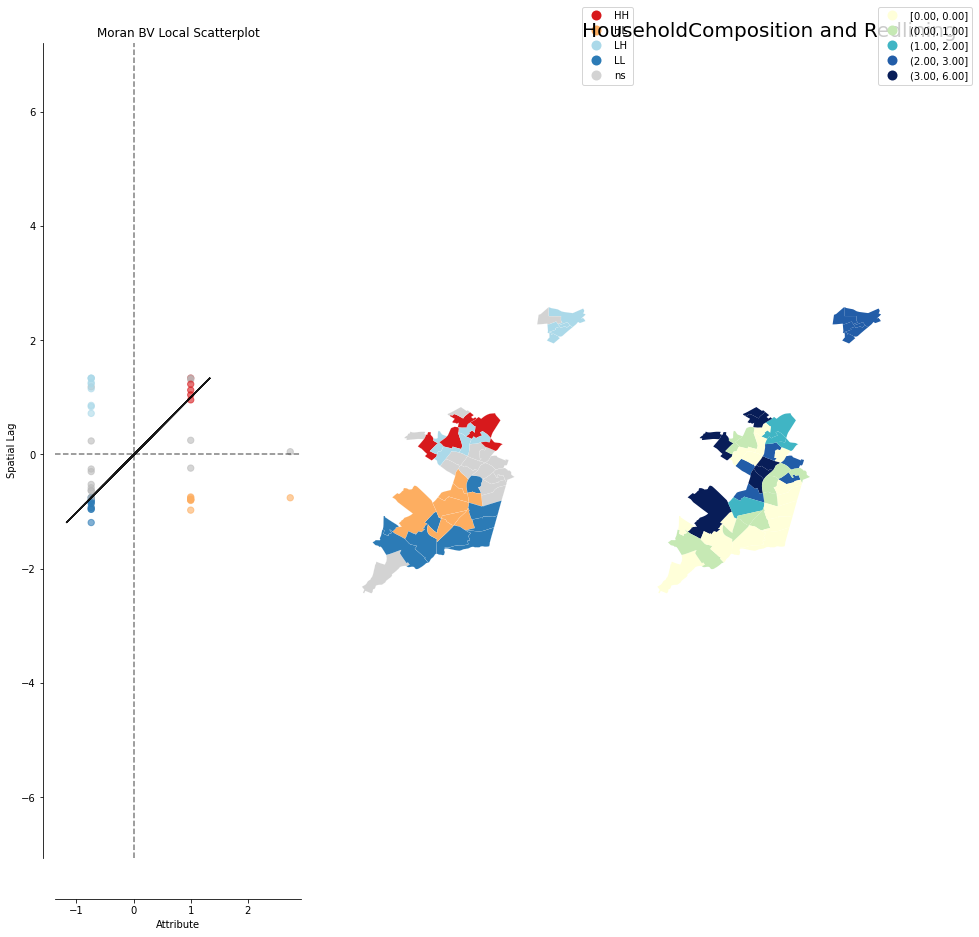

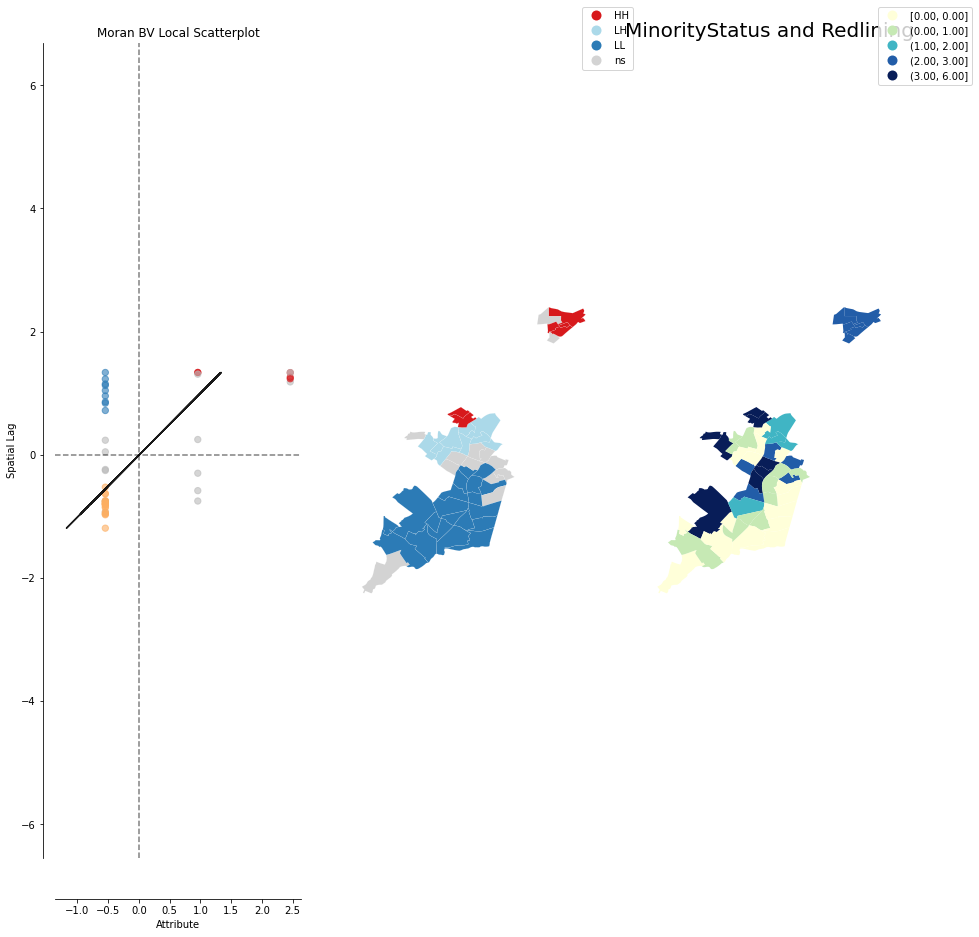

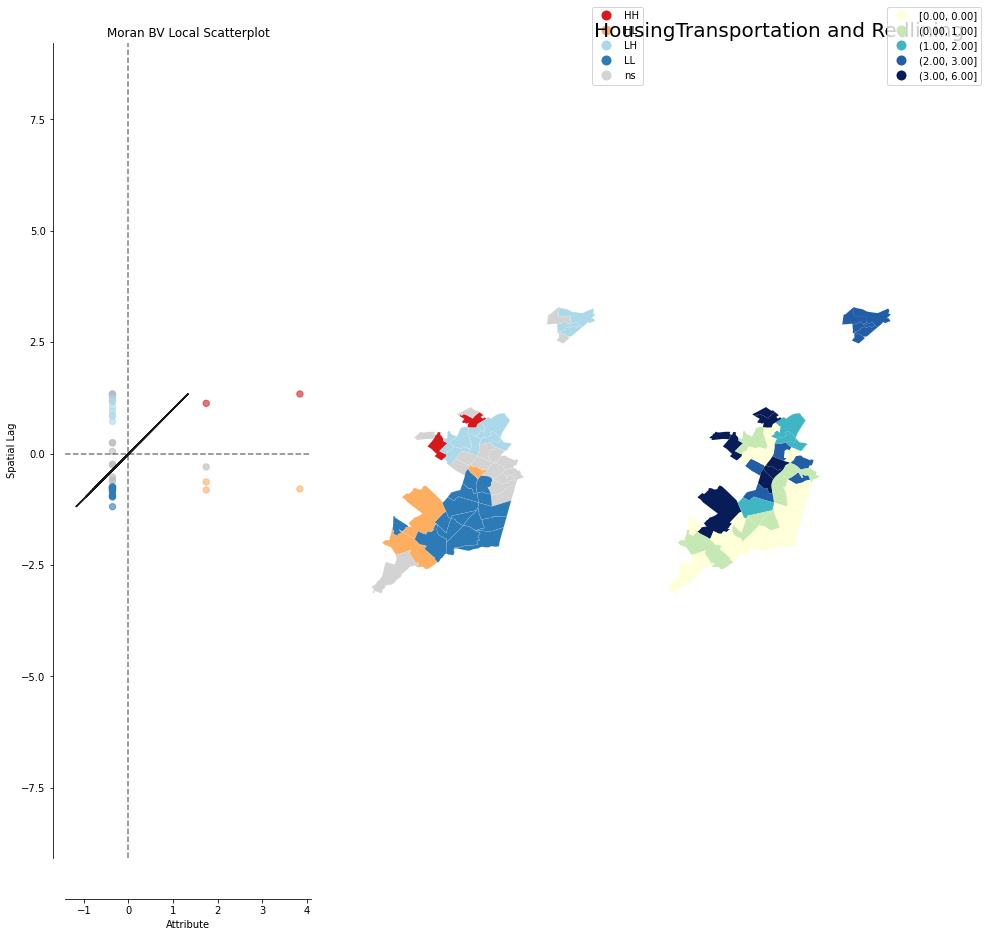

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SDH','Sociodemographic','HouseholdComposition','Minority','HousingTransportation'])

#Dropping null values
minority_sdh_boston = minority_sdh_boston.dropna()

#Renaming columns 
minority_sdh_boston = minority_sdh_boston.rename(columns={'ordinal_value':'redlining_index'})

#Getting all SVI columns
SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

t = [25025061101.0,25025140106.0,25025060700.0]
minority_sdh_boston = minority_sdh_boston.loc[~minority_sdh_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(minority_sdh_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SDH_corr_vars:
#Running spatial correlations
    y = minority_sdh_boston[i].values
    x = minority_sdh_boston['reweighted_redline_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    plot_local_autocorrelation(moran_loc_bv, minority_sdh_boston, 'SDH', figsize=(15,15))
    #Adding a column for cluster values
    minority_sdh_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Redlining'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr

,SDH,Sociodemographic,HouseholdComposition,Minority,HousingTransportation
0,0.400386,0.303645,0.047078,0.484655,0.020577


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_spearman = pd.DataFrame(columns=['SDH','SDH_pval','Sociodemographic','Sociodemographic_pval','HouseholdComposition','HouseholdComposition_pval','MinorityStatus','MinorityStatus_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

for i in SDH_corr_vars:
    
    #Making subset with dropped NA's
    minority_sdh_boston_spearman = minority_sdh_boston.copy()
    minority_sdh_boston_spearman = minority_sdh_boston.dropna()

    spearman_corr =  spearmanr(minority_sdh_boston_spearman['reweighted_redline_index'], minority_sdh_boston_spearman[i])[0]
    p_val = spearmanr(minority_sdh_boston_spearman['reweighted_redline_index'], minority_sdh_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(minority_spearman)
minority_spearman.loc[df_length] = corr_list
minority_spearman

,SDH,SDH_pval,Sociodemographic,Sociodemographic_pval,HouseholdComposition,HouseholdComposition_pval,MinorityStatus,MinorityStatus_pval,HousingTransportation,HousingTransportation_pval
0,0.252088,0.087374,0.221514,0.134552,0.016643,0.91159,0.455867,0.001281,-0.093522,0.531801


In [ ]:
#Reassigning cluster values such that 1 = HH, 2 = HL, 3 = LH, 4 = LL
def cluster_assign(row):

    if row == 2:
        val = 3
    elif row == 3:
        val = 4
    elif row == 4:
        val = 2
    else:
        val = 1

    return val

In [ ]:
#Applying clusters

minority_sdh_boston['SDH_cluster'] = minority_sdh_boston['SDH_cluster'].apply(cluster_assign)
minority_sdh_boston['Sociodemographic_cluster'] = minority_sdh_boston['Sociodemographic_cluster'].apply(cluster_assign)
minority_sdh_boston['HouseholdComposition_cluster'] = minority_sdh_boston['HouseholdComposition_cluster'].apply(cluster_assign)
minority_sdh_boston['MinorityStatus_cluster'] = minority_sdh_boston['MinorityStatus_cluster'].apply(cluster_assign)
minority_sdh_boston['HousingTransportation_cluster'] = minority_sdh_boston['HousingTransportation_cluster'].apply(cluster_assign)

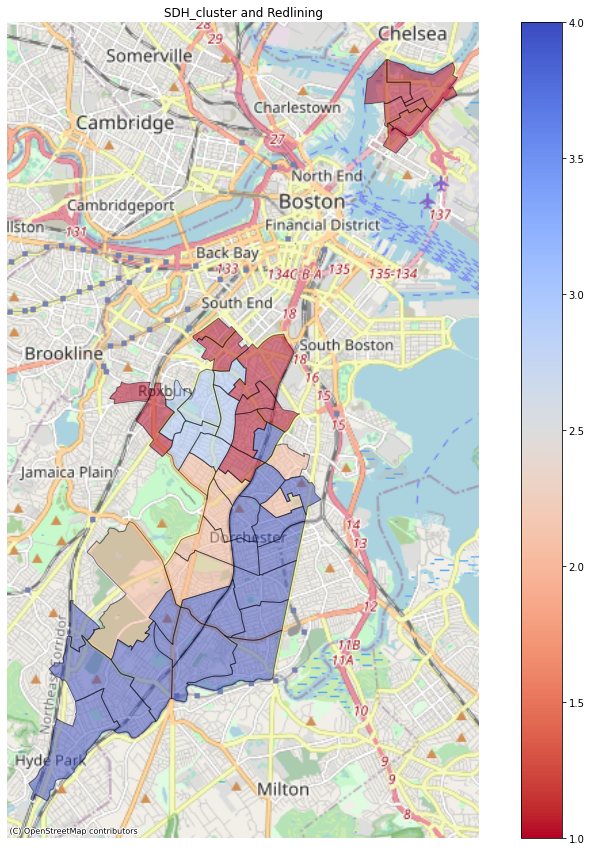

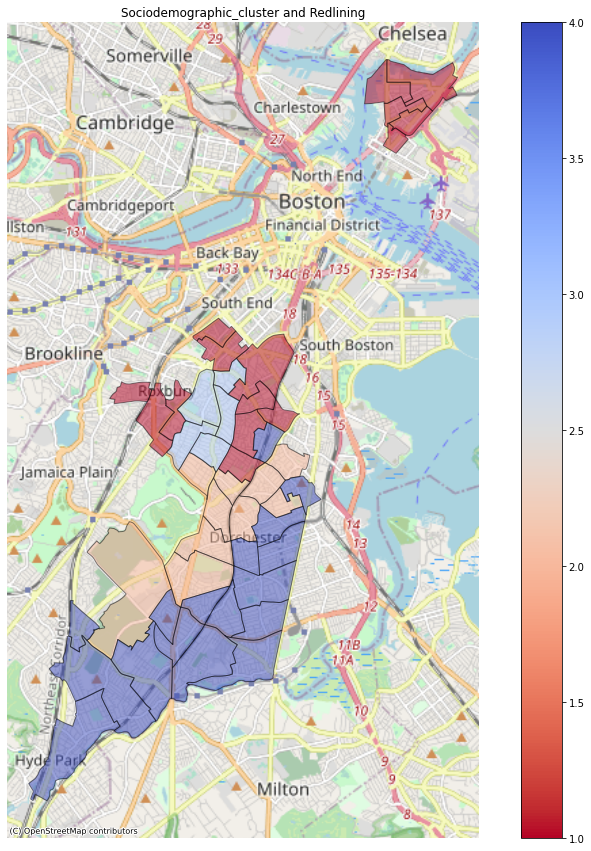

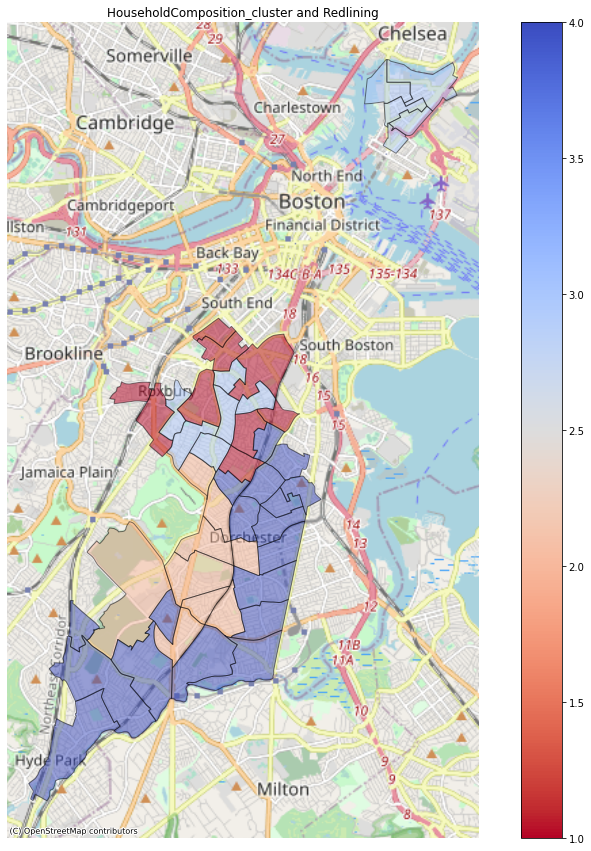

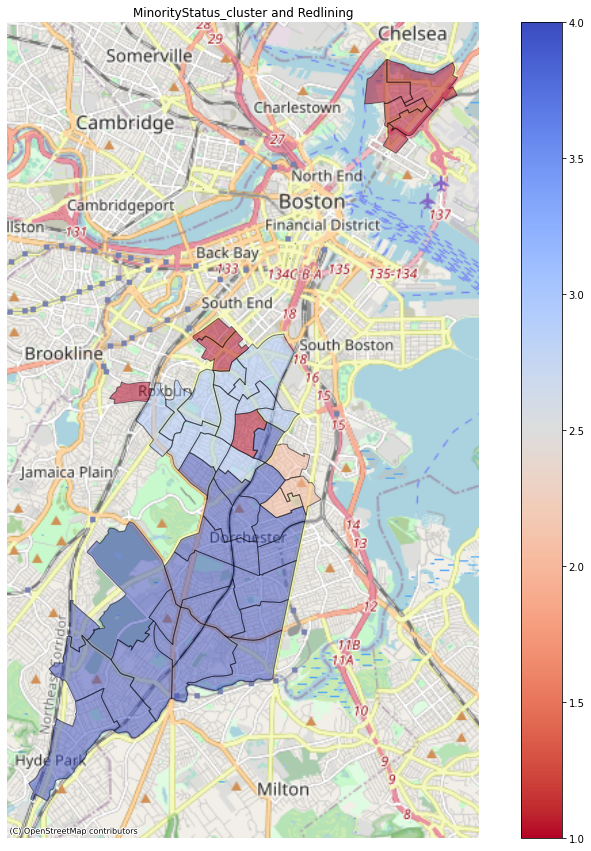

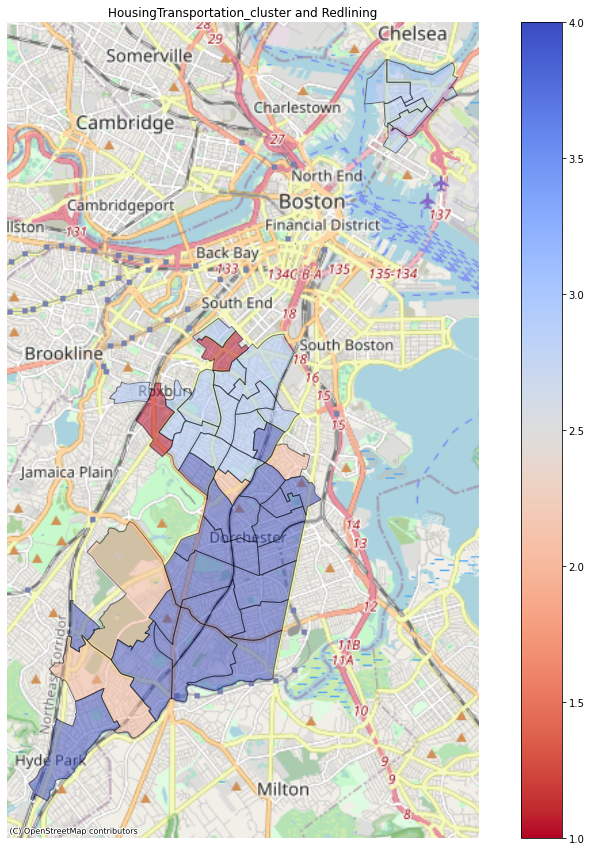

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SDH_cluster','Sociodemographic_cluster','HouseholdComposition_cluster','MinorityStatus_cluster','HousingTransportation_cluster']
for i in cluster_list:
    ax = minority_sdh_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin=1, vmax=4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Redlining'.format(i))
    ax.set_axis_off()

## Correlations with rental index

In [ ]:
#Loading rental prioritisation data for rental assistance index and minortiy percentage population visualisations
rent_data = gpd.read_file('/datasets/rent_prioritisation/housing_index_state_adj.geojson')
#Converting GEOID from string to float for merging
rent_data['GEOID'] = rent_data['GEOID'].astype(float)
rent_data = rent_data.rename(columns={'GEOID':'geo_id'})

#Merging SVI with geo df 
gdf_Boston = gdf_Boston.merge(rent_data[['geo_id','total_index_quantile']], on ='geo_id', how ='left')
gdf_Boston.head()

,STATEFP,COUNTYFP,TRACTCE,geo_id,NAME,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,...,median_rent,children_in_single_female_hh_perc,mortgaged_housing_units_perc,owner_occupied_housing_units_perc,not_us_citizen_pop_perc,male_pop_perc,non_white_perc,reweighted_redline_index,ordinal_value,total_index_quantile
0,25,025,010600,2.502501e+10,106,Census Tract 106,G5020,S,339678,0,...,2629.0,0.039343,0.079183,0.113257,0.160572,0.409539,0.312560,3.904488,4.0,0.66
1,25,025,120500,2.502512e+10,1205,Census Tract 1205,G5020,S,213706,0,...,1236.0,0.158203,0.236328,0.276515,0.116436,0.519347,0.615903,3.725805,4.0,0.82
2,25,025,070600,2.502507e+10,706,Census Tract 706,G5020,S,133036,0,...,2578.0,0.000000,0.462192,0.646253,0.016803,0.464244,0.203986,4.000000,4.0,0.43
3,25,025,140201,2.502514e+10,1402.01,Census Tract 1402.01,G5020,S,1322336,99423,...,1227.0,0.097955,0.335845,0.400000,0.127273,0.523636,0.663838,3.000000,3.0,0.69
4,25,025,082100,2.502508e+10,821,Census Tract 821,G5020,S,370577,0,...,413.0,0.426458,0.104874,0.116533,0.153913,0.441739,0.954957,3.000000,3.0,0.96


In [ ]:
gdf_Boston.columns

Index(['STATEFP', 'COUNTYFP', 'TRACTCE', 'geo_id', 'NAME', 'NAMELSAD', 'MTFCC',
       'FUNCSTAT', 'ALAND', 'AWATER', 'INTPTLAT', 'INTPTLON', 'geometry',
       'housing_built_1939_or_earlier_perc', 'no_cars_perc',
       'multi_unit_structures_perc', 'median_year_structure_built',
       'less_than_high_school_graduate_perc', 'aged_65_or_older_perc',
       'married_households_perc', 'households_public_asst_or_food_stamps_perc',
       'management_business_sci_arts_employed_perc', 'median_age',
       'households', 'asian_pop_perc', 'hispanic_pop_perc',
       'bachelors_degree_or_higher_25_64', 'median_rent',
       'children_in_single_female_hh_perc', 'mortgaged_housing_units_perc',
       'owner_occupied_housing_units_perc', 'not_us_citizen_pop_perc',
       'male_pop_perc', 'non_white_perc', 'reweighted_redline_index',
       'ordinal_value', 'total_index_quantile'],
      dtype='object')

In [ ]:
# Remove duplicates and null values from the SVI-based variables dataset before further processing
gdf_Boston.drop_duplicates(inplace=True)
gdf_Boston.dropna(inplace=True)

In [ ]:
#Making a copy of the Boston data to use for subsetting minority populations later
sdh_boston_minority = gdf_Boston.copy()

#Making a copy of the Boston data to use for creating SDH variables for all census tracts
sdh_boston = gdf_Boston.copy()

#Creating flags as values with 90th/10th percentile

sdh_boston.loc[sdh_boston['less_than_high_school_graduate_perc'] >= sdh_boston['less_than_high_school_graduate_perc'].quantile(0.9), 'less_than_high_school_graduate_flag'] = 1
sdh_boston['less_than_high_school_graduate_flag'] = sdh_boston['less_than_high_school_graduate_flag'].fillna(0)

#sdh_boston.loc['male_pop_perc'] <= sdh_boston['male_pop_perc'].quantile(0.1), 'male_pop_flag'] = 1
#sdh_boston['male_pop_flag'] = sdh_boston['male_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['management_business_sci_arts_employed_perc'] >= sdh_boston['management_business_sci_arts_employed_perc'].quantile(0.9), 'management_business_sci_arts_employed_flag'] = 1
sdh_boston['management_business_sci_arts_employed_flag'] = sdh_boston['management_business_sci_arts_employed_flag'].fillna(0)

sdh_boston.loc[sdh_boston['children_in_single_female_hh_perc'] >= sdh_boston['children_in_single_female_hh_perc'].quantile(0.9), 'children_in_single_female_hh_flag'] = 1
sdh_boston['children_in_single_female_hh_flag'] = sdh_boston['children_in_single_female_hh_flag'].fillna(0)

sdh_boston.loc[sdh_boston['asian_pop_perc'] >= sdh_boston['asian_pop_perc'].quantile(0.9), 'asian_pop_flag'] = 1
sdh_boston['asian_pop_flag'] = sdh_boston['asian_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['no_cars_perc'] >= sdh_boston['no_cars_perc'].quantile(0.9), 'no_cars_flag'] = 1
sdh_boston['no_cars_flag'] = sdh_boston['no_cars_flag'].fillna(0)

sdh_boston.loc[sdh_boston['not_us_citizen_pop_perc'] >= sdh_boston['not_us_citizen_pop_perc'].quantile(0.9), 'not_us_citizen_pop_flag'] = 1
sdh_boston['not_us_citizen_pop_flag'] = sdh_boston['not_us_citizen_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['hispanic_pop_perc'] >= sdh_boston['hispanic_pop_perc'].quantile(0.9), 'hispanic_pop_flag'] = 1
sdh_boston['hispanic_pop_flag'] = sdh_boston['hispanic_pop_flag'].fillna(0)

sdh_boston.loc[sdh_boston['aged_65_or_older_perc'] >= sdh_boston['aged_65_or_older_perc'].quantile(0.9), 'aged_65_or_older_flag'] = 1
sdh_boston['aged_65_or_older_flag'] = sdh_boston['aged_65_or_older_flag'].fillna(0)

sdh_boston.loc[sdh_boston['mortgaged_housing_units_perc'] >= sdh_boston['mortgaged_housing_units_perc'].quantile(0.9), 'mortgaged_housing_units_flag'] = 1
sdh_boston['mortgaged_housing_units_flag'] = sdh_boston['mortgaged_housing_units_flag'].fillna(0)

sdh_boston.loc[sdh_boston['households_public_asst_or_food_stamps_perc'] >= sdh_boston['households_public_asst_or_food_stamps_perc'].quantile(0.9), 'households_public_asst_or_food_stamps_flag'] = 1
sdh_boston['households_public_asst_or_food_stamps_flag'] = sdh_boston['households_public_asst_or_food_stamps_flag'].fillna(0)

sdh_boston.loc[sdh_boston['housing_built_1939_or_earlier_perc'] <= sdh_boston['housing_built_1939_or_earlier_perc'].quantile(0.1), 'housing_built_1939_or_earlier_flag'] = 1
sdh_boston['housing_built_1939_or_earlier_flag'] = sdh_boston['housing_built_1939_or_earlier_flag'].fillna(0)

sdh_boston.loc[sdh_boston['multi_unit_structures_perc'] >= sdh_boston['multi_unit_structures_perc'].quantile(0.9), 'multi_unit_structures_flag'] = 1
sdh_boston['multi_unit_structures_flag'] = sdh_boston['multi_unit_structures_flag'].fillna(0)

sdh_boston.loc[sdh_boston['owner_occupied_housing_units_perc'] <= sdh_boston['owner_occupied_housing_units_perc'].quantile(0.1), 'owner_occupied_housing_units_flag'] = 1
sdh_boston['owner_occupied_housing_units_flag'] = sdh_boston['owner_occupied_housing_units_flag'].fillna(0)

sdh_boston.loc[sdh_boston['married_households_perc'] <= sdh_boston['married_households_perc'].quantile(0.1), 'married_households_flag'] = 1
sdh_boston['married_households_flag'] = sdh_boston['married_households_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_year_structure_built'] >= sdh_boston['median_year_structure_built'].quantile(0.9), 'median_year_structure_built_flag'] = 1
sdh_boston['median_year_structure_built_flag'] = sdh_boston['median_year_structure_built_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_age'] <= sdh_boston['median_age'].quantile(0.1), 'median_age_flag'] = 1
sdh_boston['median_age_flag'] = sdh_boston['median_age_flag'].fillna(0)

sdh_boston.loc[sdh_boston['bachelors_degree_or_higher_25_64'] <= sdh_boston['bachelors_degree_or_higher_25_64'].quantile(0.1), 'bachelors_degree_or_higher_25_64_flag'] = 1
sdh_boston['bachelors_degree_or_higher_25_64_flag'] = sdh_boston['bachelors_degree_or_higher_25_64_flag'].fillna(0)

sdh_boston.loc[sdh_boston['median_rent'] <= sdh_boston['median_rent'].quantile(0.1), 'median_rent_flag'] = 1
sdh_boston['median_rent_flag'] = sdh_boston['median_rent_flag'].fillna(0)

In [ ]:
# The number of flags (for each tract), all SVI-based variables
sdh_boston['SDH'] = sdh_boston['less_than_high_school_graduate_flag'] + sdh_boston['management_business_sci_arts_employed_flag'] + sdh_boston['children_in_single_female_hh_flag'] + sdh_boston['asian_pop_flag'] + sdh_boston['no_cars_flag'] + sdh_boston['not_us_citizen_pop_flag'] + sdh_boston['hispanic_pop_flag'] + sdh_boston['aged_65_or_older_flag'] + sdh_boston['mortgaged_housing_units_flag'] + sdh_boston['households_public_asst_or_food_stamps_flag'] + sdh_boston['housing_built_1939_or_earlier_flag'] + sdh_boston['multi_unit_structures_flag'] + sdh_boston['owner_occupied_housing_units_flag'] + sdh_boston['married_households_flag'] + sdh_boston['median_year_structure_built_flag'] + sdh_boston['median_age_flag'] + sdh_boston['bachelors_degree_or_higher_25_64_flag'] + sdh_boston['median_rent_flag']

# The number of flags (for each tract); Theme#1: Socio-Demographic Status
sdh_boston['Sociodemographic'] = sdh_boston['less_than_high_school_graduate_flag'] + sdh_boston['management_business_sci_arts_employed_flag'] + sdh_boston['households_public_asst_or_food_stamps_flag'] + sdh_boston['median_age_flag'] + sdh_boston['bachelors_degree_or_higher_25_64_flag'] + sdh_boston['median_rent_flag']

# The number of flags (for each tract); Theme#2: Household Composition & Disability
sdh_boston['HouseholdComposition'] = sdh_boston['aged_65_or_older_flag'] + sdh_boston['children_in_single_female_hh_flag'] + sdh_boston['married_households_flag'] 

# The number of flags (for each tract); Theme#3: Minority Status & Language
sdh_boston['MinorityStatus'] = sdh_boston['asian_pop_flag'] + sdh_boston['not_us_citizen_pop_flag'] + sdh_boston['hispanic_pop_flag']

# The number of flags (for each tract); Theme#4: Housing Type & Transportation
sdh_boston['HousingTransportation'] = sdh_boston['no_cars_flag'] + sdh_boston['mortgaged_housing_units_flag'] + sdh_boston['housing_built_1939_or_earlier_flag'] + sdh_boston['multi_unit_structures_flag'] + sdh_boston['median_year_structure_built_flag']

[0.17747032454170916]


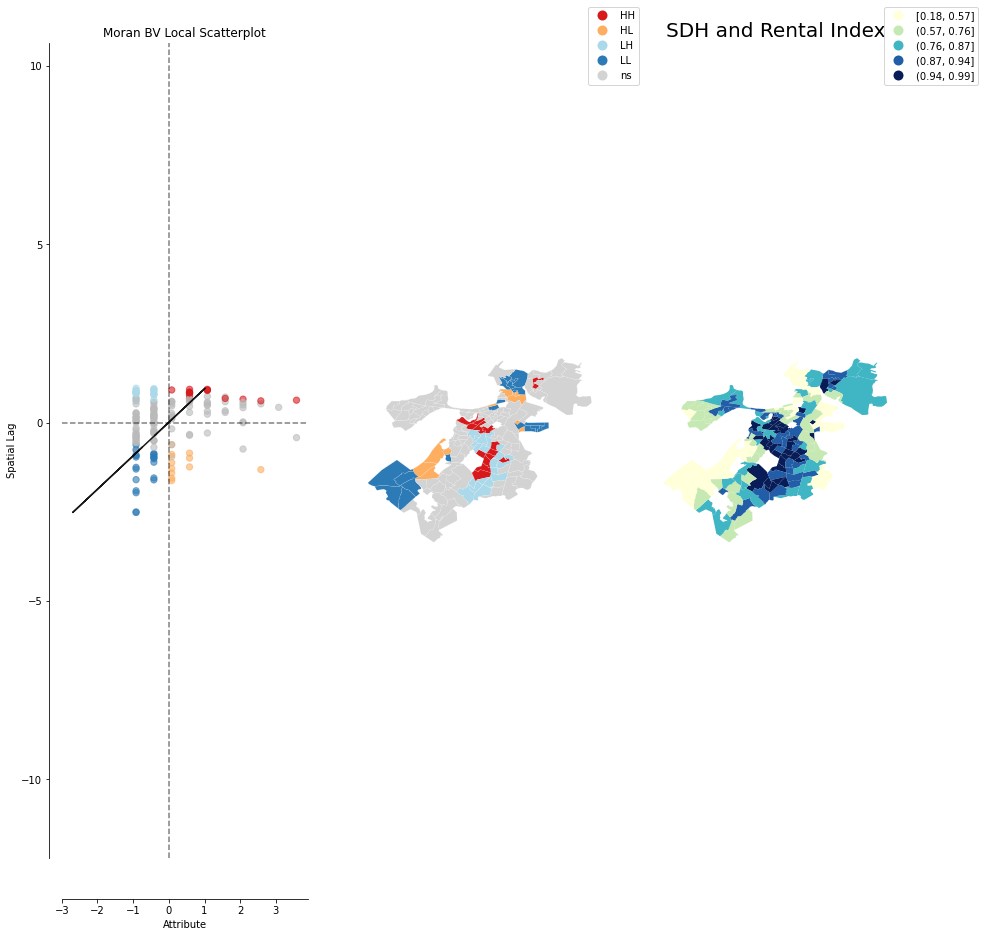

[0.17747032454170916, 0.16794503489385695]


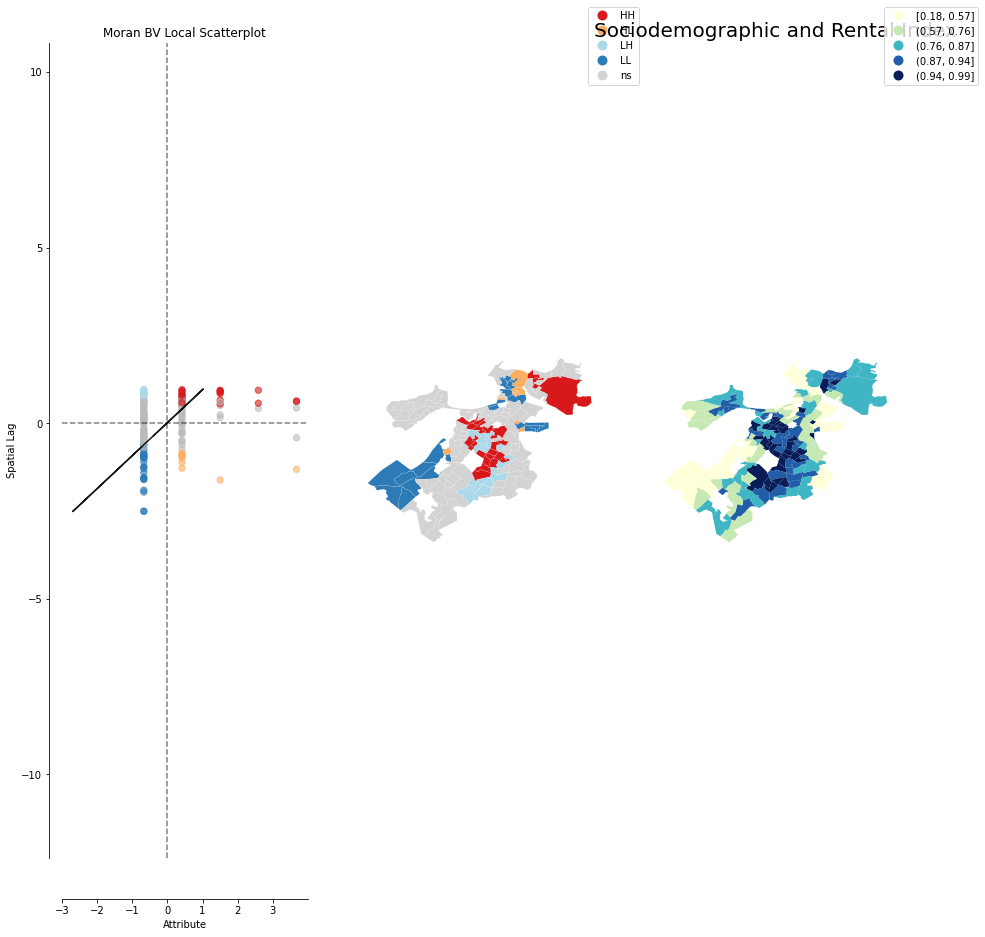

[0.17747032454170916, 0.16794503489385695, 0.10216501638720411]


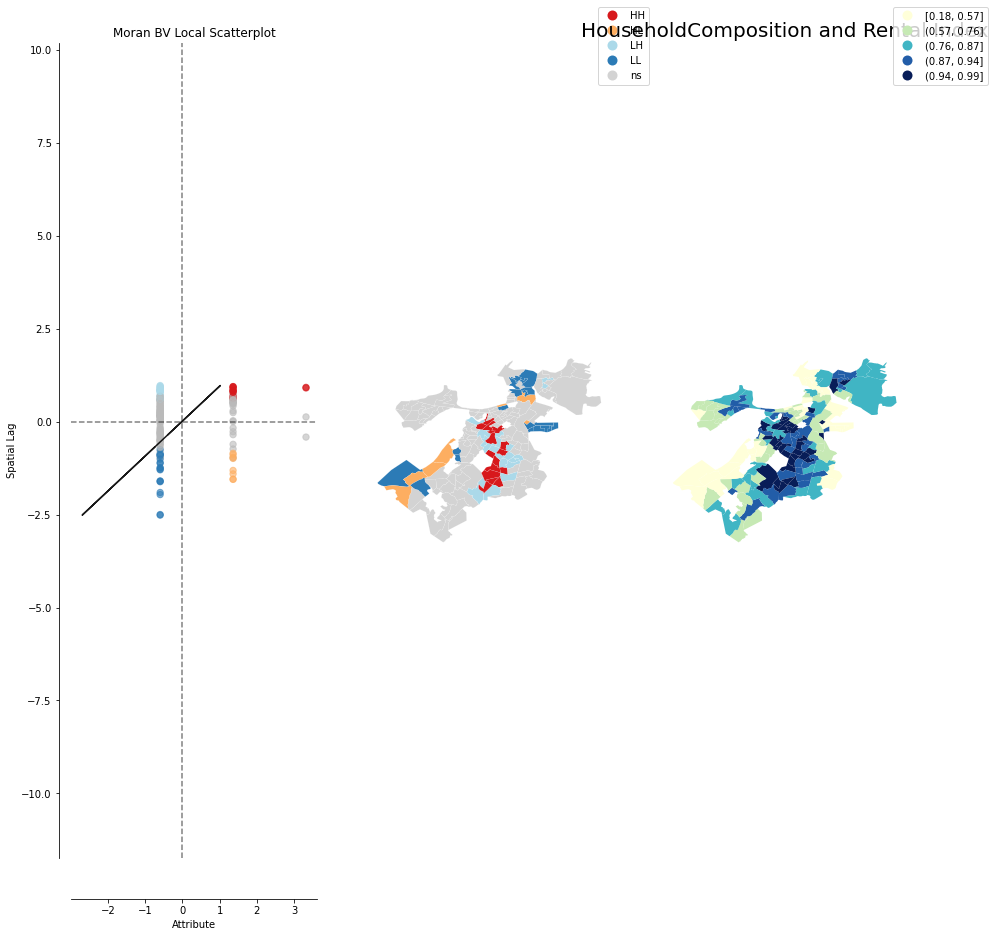

[0.17747032454170916, 0.16794503489385695, 0.10216501638720411, 0.20656411259310886]


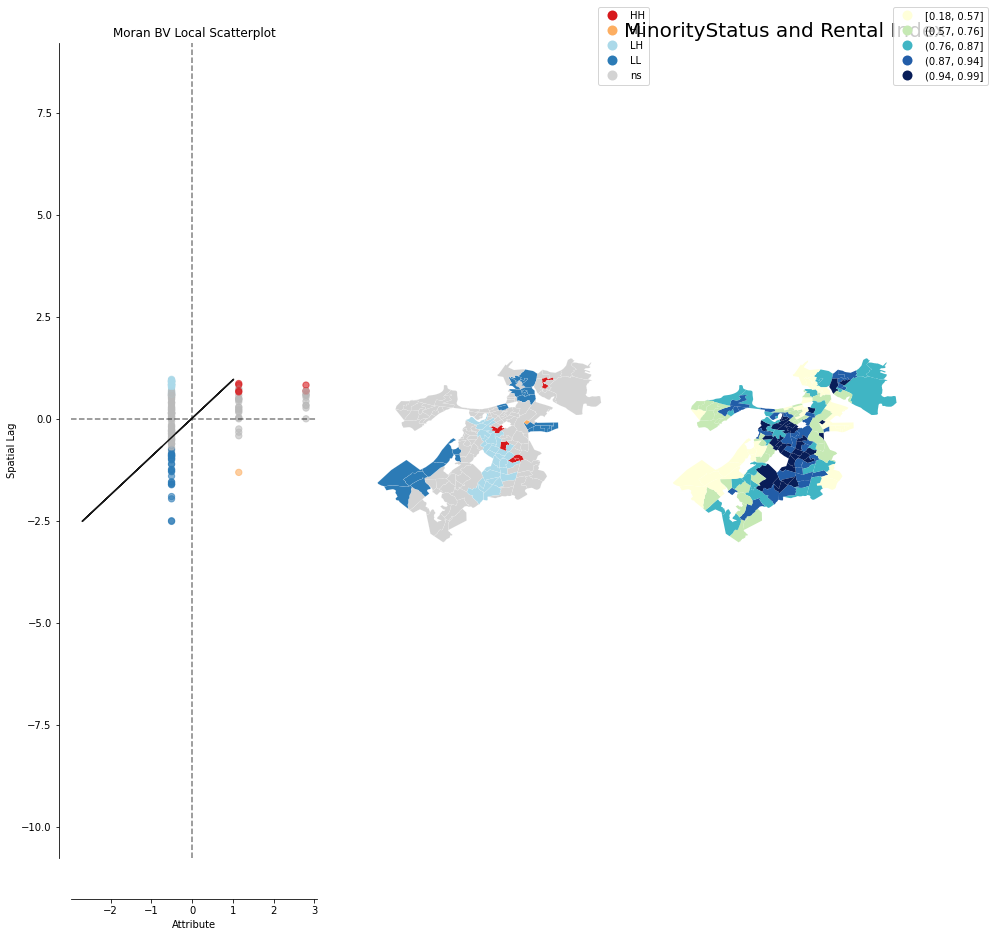

[0.17747032454170916, 0.16794503489385695, 0.10216501638720411, 0.20656411259310886, -0.010966475968149354]


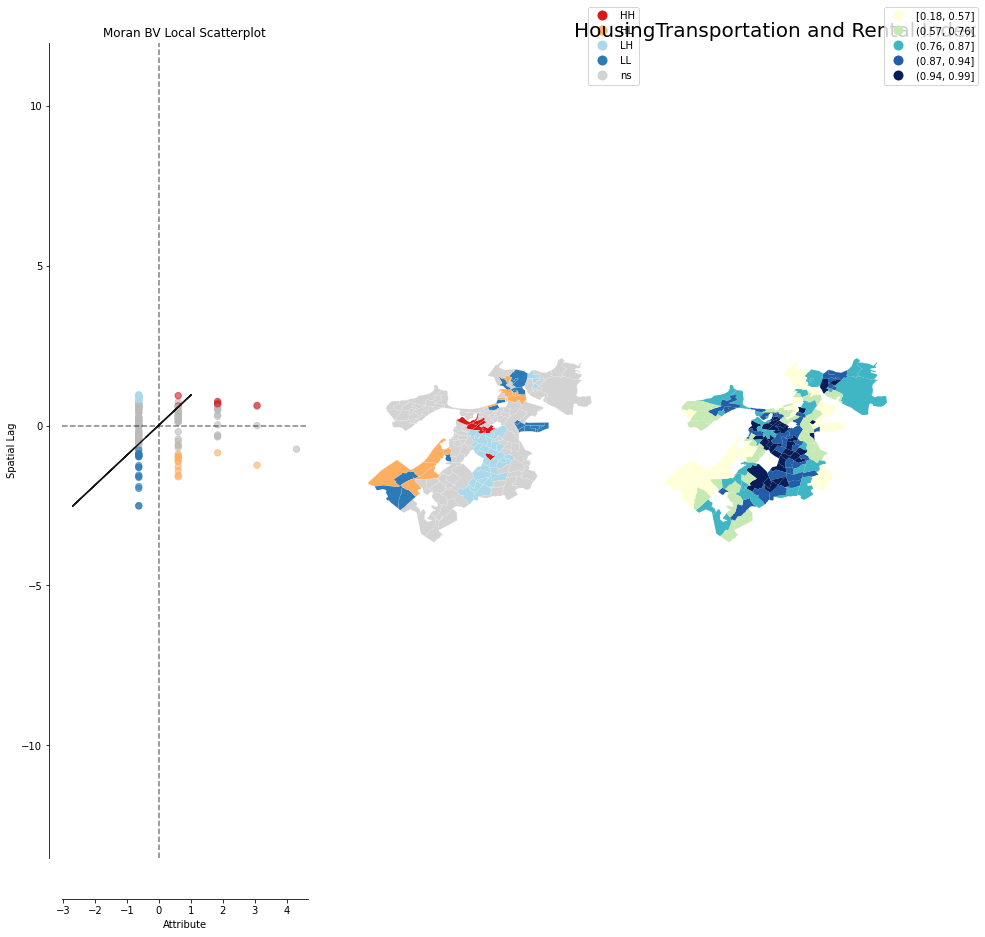

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation'])

#Dropping null values
sdh_boston = sdh_boston.dropna()

#Renaming columns 
sdh_boston = sdh_boston.rename(columns={'total_index_quantile':'rental_index'})

#Getting all SVI columns
SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

#Spatial transformations
w = Queen.from_dataframe(sdh_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SDH_corr_vars:
#Running spatial correlations
    y = sdh_boston[i].values
    x = sdh_boston['rental_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    print(corr_list)
    plot_local_autocorrelation(moran_loc_bv, sdh_boston,'rental_index', figsize=(15,15))
    #Adding a column for cluster values
    sdh_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Rental Index'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr

,SDH,Sociodemographic,HouseholdComposition,MinorityStatus,HousingTransportation
0,0.17747,0.167945,0.102165,0.206564,-0.010966


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
spearman = pd.DataFrame(columns=['SDH','SDH_pval','Sociodemographic','Sociodemographic_pval','HouseholdComposition','HouseholdComposition_pval','MinorityStatus','MinorityStatus_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

for i in SDH_corr_vars:
    
    #Making subset with dropped NA's
    sdh_boston_spearman = sdh_boston.copy()
    sdh_boston_spearman = sdh_boston_spearman.dropna()

    spearman_corr =  spearmanr(sdh_boston_spearman['reweighted_redline_index'], sdh_boston_spearman[i])[0]
    p_val = spearmanr(sdh_boston_spearman['reweighted_redline_index'], sdh_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(spearman)
spearman.loc[df_length] = corr_list
spearman

,SDH,SDH_pval,Sociodemographic,Sociodemographic_pval,HouseholdComposition,HouseholdComposition_pval,MinorityStatus,MinorityStatus_pval,HousingTransportation,HousingTransportation_pval
0,0.256576,0.000817,0.272537,0.000366,-0.033786,0.664683,0.237375,0.00201,0.089908,0.247891


In [ ]:
#Applying clusters

sdh_boston['SDH_cluster'] = sdh_boston['SDH_cluster'].apply(cluster_assign)
sdh_boston['Sociodemographic_cluster'] = sdh_boston['Sociodemographic_cluster'].apply(cluster_assign)
sdh_boston['HouseholdComposition_cluster'] = sdh_boston['HouseholdComposition_cluster'].apply(cluster_assign)
sdh_boston['MinorityStatus_cluster'] = sdh_boston['MinorityStatus_cluster'].apply(cluster_assign)
sdh_boston['HousingTransportation_cluster'] = sdh_boston['HousingTransportation_cluster'].apply(cluster_assign)

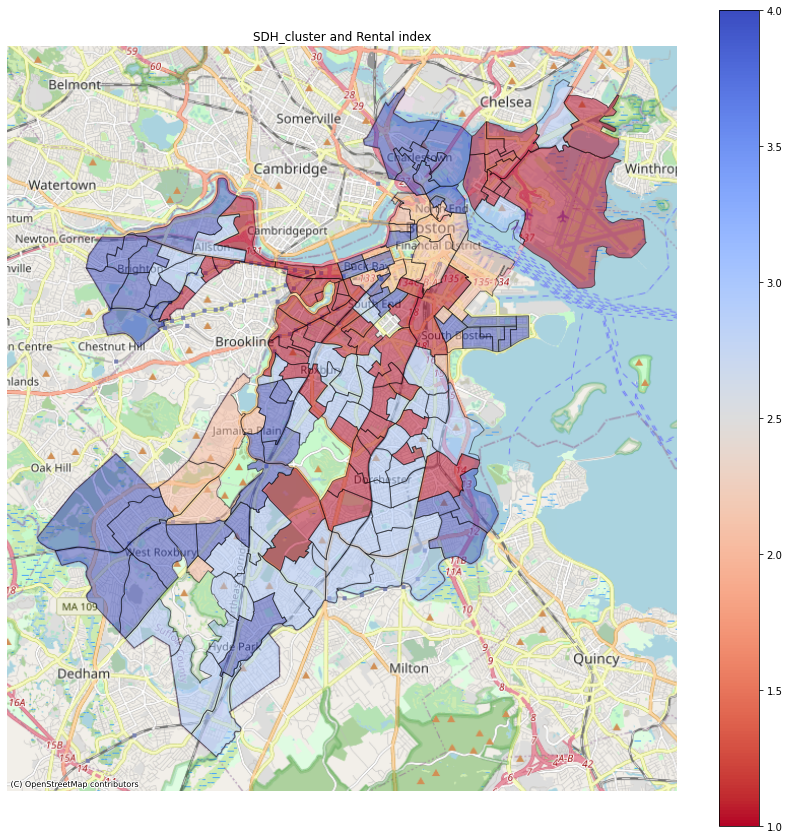

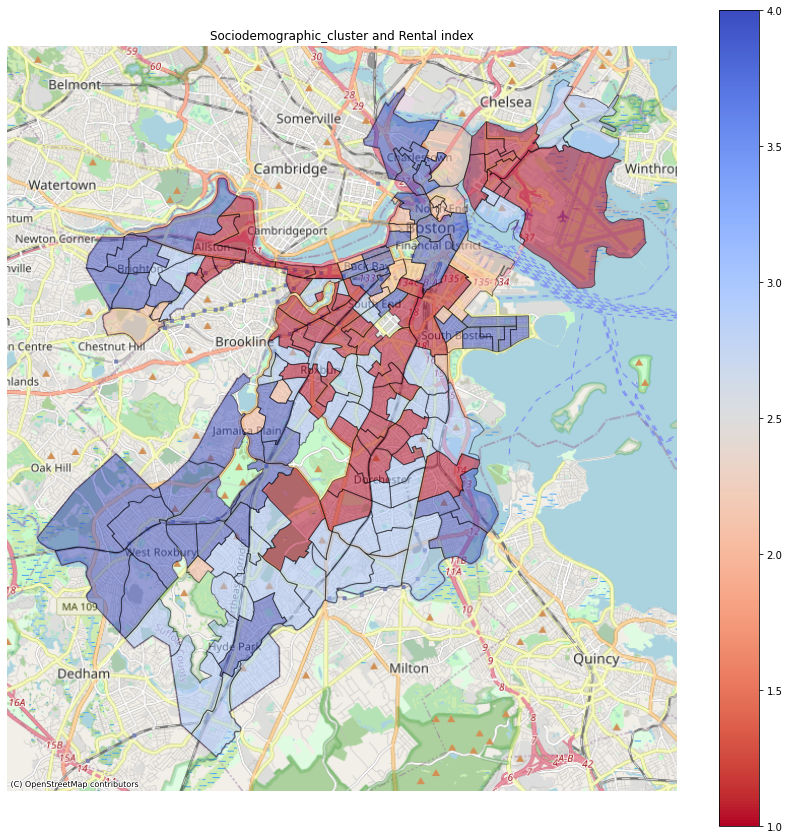

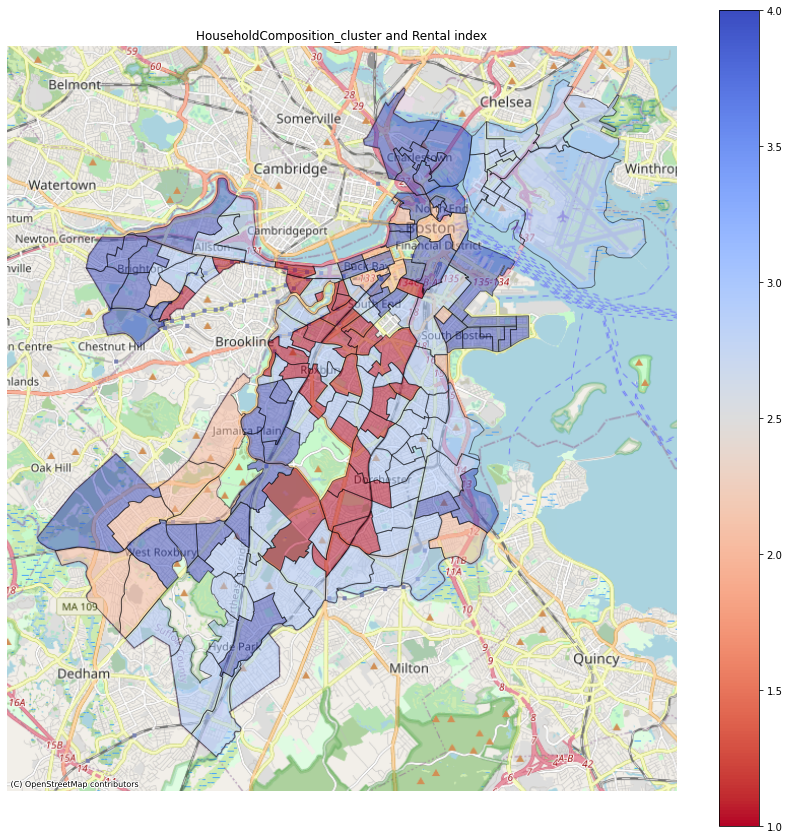

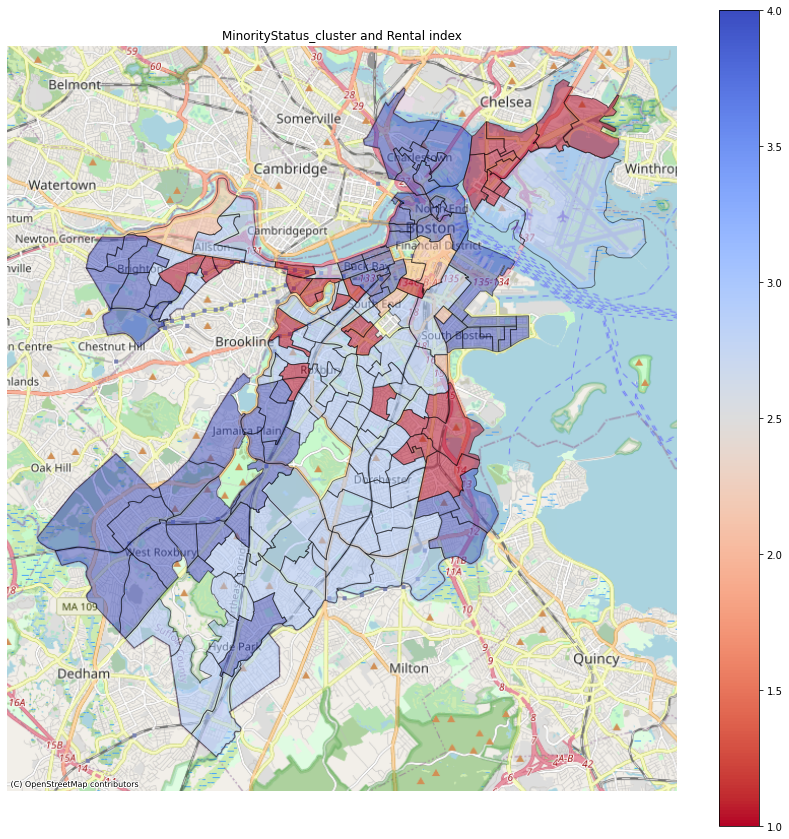

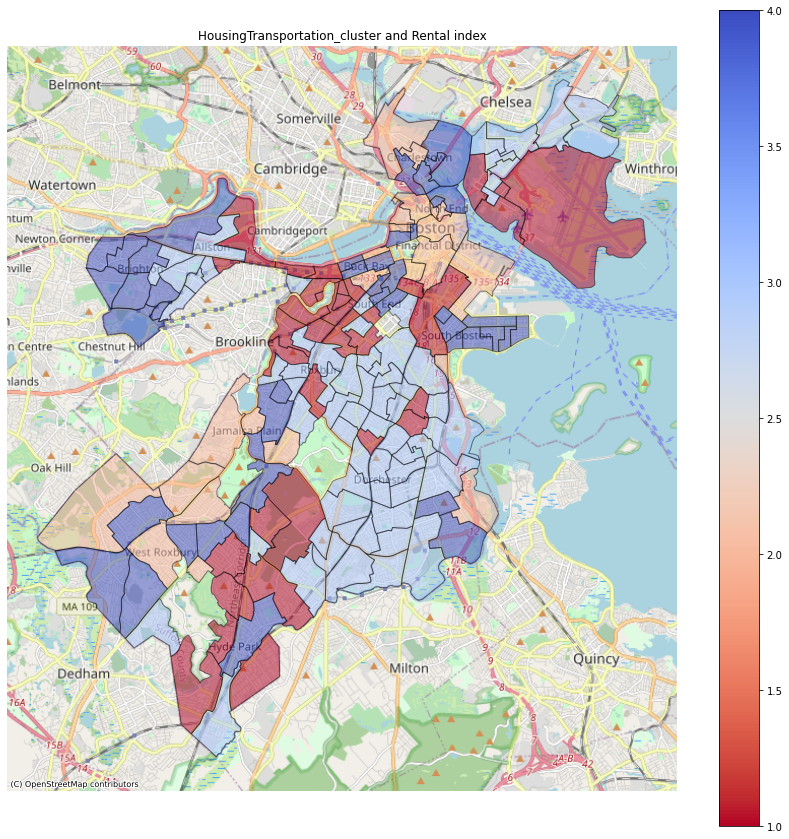

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SDH_cluster','Sociodemographic_cluster','HouseholdComposition_cluster','MinorityStatus_cluster','HousingTransportation_cluster']
for i in cluster_list:
    ax = sdh_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin=1, vmax=4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Rental index'.format(i))
    ax.set_axis_off()

### Rental Correlations (>70% minority threshold)

In [ ]:
#Creating flags as values with 90th/10th percentile

sdh_boston.loc[sdh_boston['non_white_perc'] >= sdh_boston['non_white_perc'].quantile(0.7), 'non_white_flag'] = 1
sdh_boston['non_white_flag'] = sdh_boston['non_white_flag'].fillna(0)
minority_sdh_boston = sdh_boston[sdh_boston['non_white_flag'] == 1]

/home/jovyan/venv/lib/python3.7/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 2 disconnected components.
  warnings.warn(message)
[0.14858307284675065]


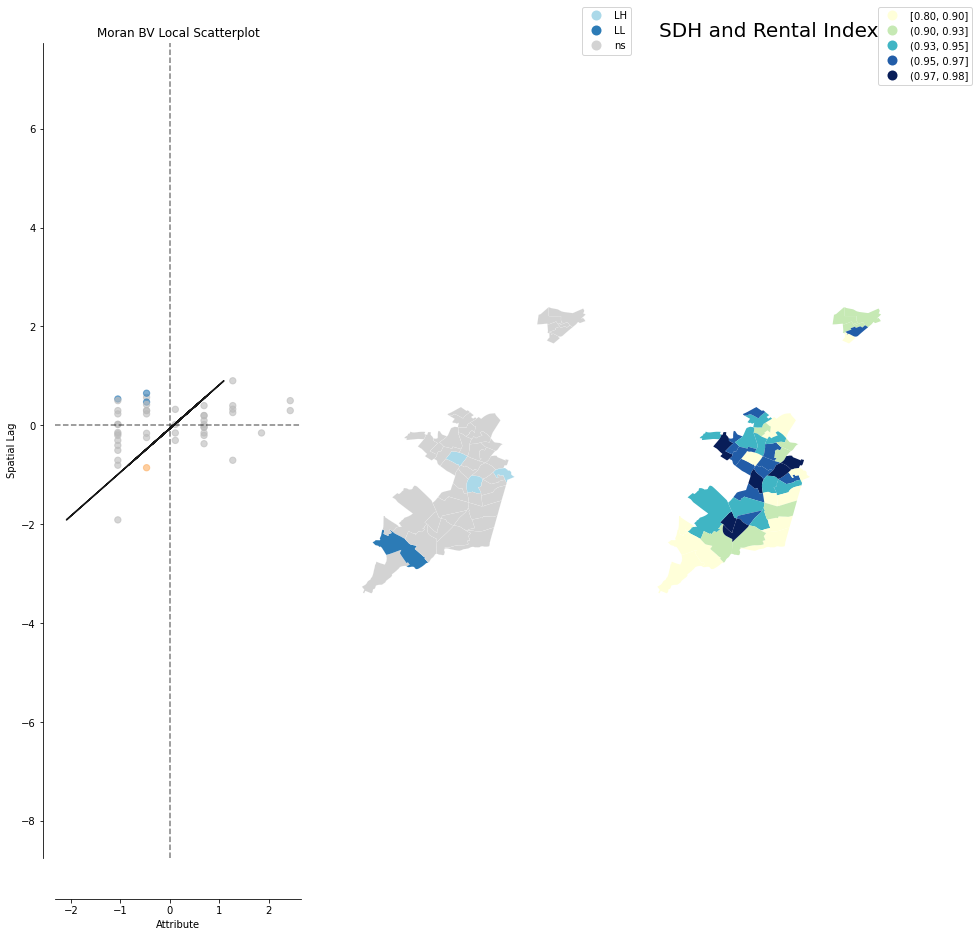

[0.14858307284675065, 0.19216370568812416]


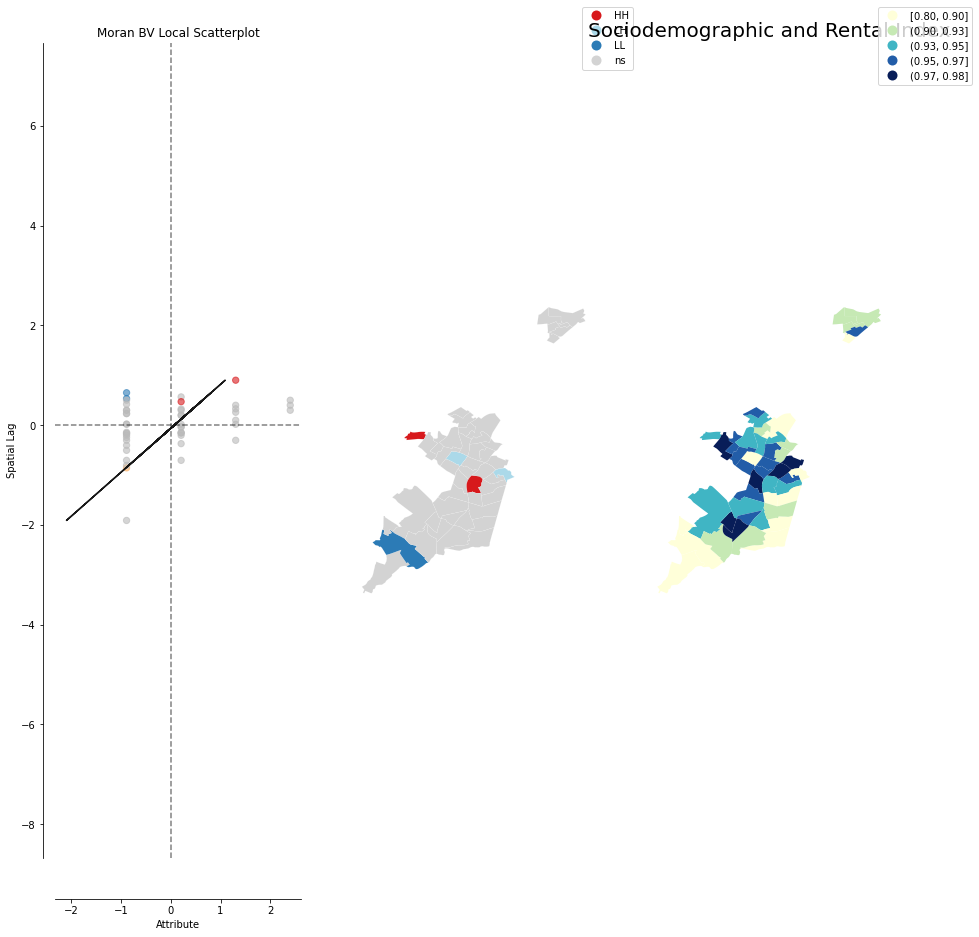

[0.14858307284675065, 0.19216370568812416, 0.1320300899024384]


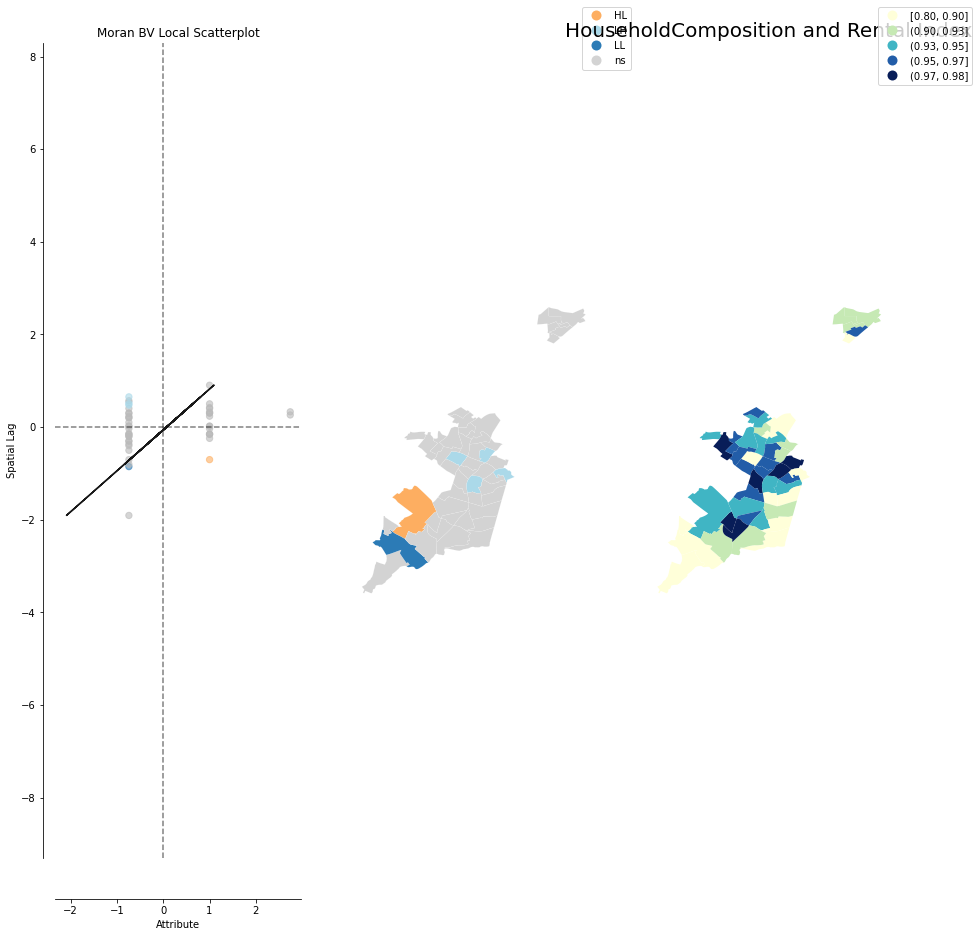

[0.14858307284675065, 0.19216370568812416, 0.1320300899024384, 0.03059533530024397]


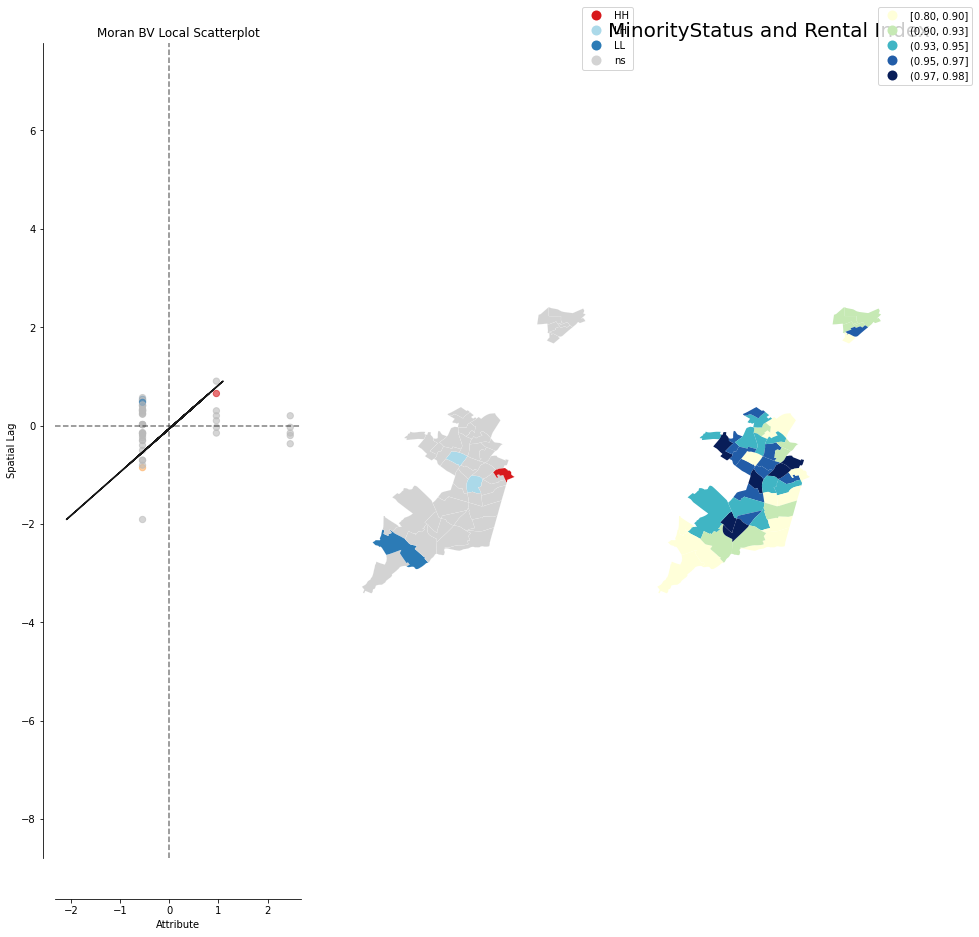

[0.14858307284675065, 0.19216370568812416, 0.1320300899024384, 0.03059533530024397, -0.074291551970213]


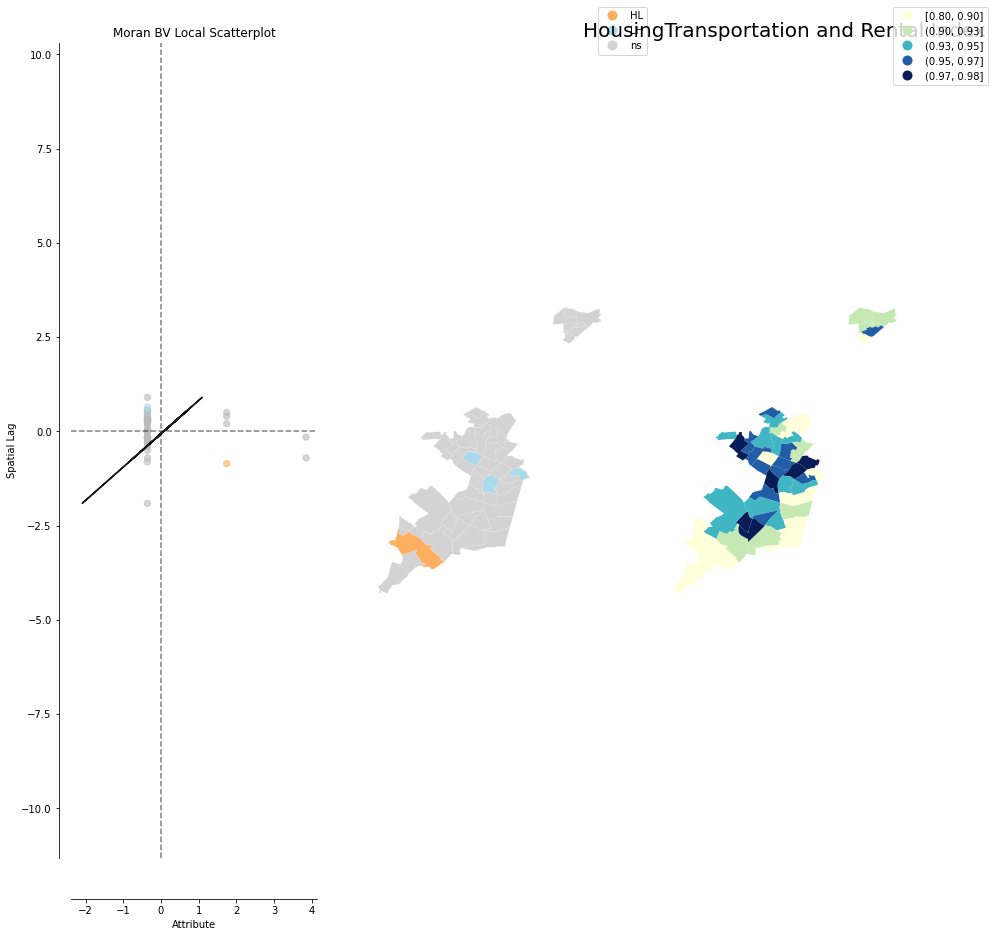

In [ ]:
#Creating spatial indices and running correlations

#Creating an empty df for storing the results of the correlation
spatial_corr = pd.DataFrame(columns=['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation'])

#Dropping null values
minority_sdh_boston = minority_sdh_boston.dropna()

#Renaming columns 
minority_sdh_boston = minority_sdh_boston.rename(columns={'total_index_quantile':'rental_index'})

#Getting all SVI columns
SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

t = [25025061101.0,25025140106.0,25025060700.0]
minority_sdh_boston = minority_sdh_boston.loc[~minority_sdh_boston.geo_id.isin(t)]

#Spatial transformations
w = Queen.from_dataframe(minority_sdh_boston)
w.transform = 'R'

#Storing values of correlation in a list
corr_list = []
for i in SDH_corr_vars:
#Running spatial correlations
    y = minority_sdh_boston[i].values
    x = minority_sdh_boston['rental_index'].values
    moran = Moran(y,w)
    moran_loc = Moran_Local(y, w)
    moran_bv = Moran_BV(y, x, w)
    moran_loc_bv = Moran_Local_BV(y, x, w, permutations = 999)
    corr_list.append(moran_bv.I)
    print(corr_list)
    plot_local_autocorrelation(moran_loc_bv, minority_sdh_boston,'rental_index', figsize=(15,15))
    #Adding a column for cluster values
    minority_sdh_boston['{}_cluster'.format(i)] = moran_loc_bv.q 
    plt.title('{} and Rental Index'.format(i), fontdict={'fontsize':20})
    plt.show()


df_length = len(spatial_corr)
spatial_corr.loc[df_length] = corr_list

In [ ]:
spatial_corr

,SDH,Sociodemographic,HouseholdComposition,MinorityStatus,HousingTransportation
0,0.148583,0.192164,0.13203,0.030595,-0.074292


In [ ]:
# Spearman and Spatial Correlations for each threshold 

##Spearman Correlations

# Creating an empty dataframe for storing results of the correlation with each minority population threshold
minority_spearman = pd.DataFrame(columns=['SDH','SDH_pval','Sociodemographic','Sociodemographic_pval','HouseholdComposition','HouseholdComposition_pval','MinorityStatus','MinorityStatus_pval','HousingTransportation','HousingTransportation_pval'])

#Storing values of correlation in a list
corr_list = []

SDH_corr_vars = ['SDH','Sociodemographic','HouseholdComposition','MinorityStatus','HousingTransportation']

for i in SDH_corr_vars:
    
    #Making subset with dropped NA's
    minority_sdh_boston_spearman = minority_sdh_boston.copy()
    minority_sdh_boston_spearman = minority_sdh_boston.dropna()

    spearman_corr =  spearmanr(minority_sdh_boston_spearman['rental_index'], minority_sdh_boston_spearman[i])[0]
    p_val = spearmanr(minority_sdh_boston_spearman['rental_index'], minority_sdh_boston_spearman[i])[1]
    corr_list.append(spearman_corr)
    corr_list.append(p_val)

df_length = len(minority_spearman)
minority_spearman.loc[df_length] = corr_list
minority_spearman

,SDH,SDH_pval,Sociodemographic,Sociodemographic_pval,HouseholdComposition,HouseholdComposition_pval,MinorityStatus,MinorityStatus_pval,HousingTransportation,HousingTransportation_pval
0,0.478548,0.000668,0.516334,0.000203,0.341623,0.018764,0.048871,0.74426,0.198916,0.18011


In [ ]:
#Applying clusters

minority_sdh_boston['SDH_cluster'] = minority_sdh_boston['SDH_cluster'].apply(cluster_assign)
minority_sdh_boston['Sociodemographic_cluster'] = minority_sdh_boston['Sociodemographic_cluster'].apply(cluster_assign)
minority_sdh_boston['HouseholdComposition_cluster'] = minority_sdh_boston['HouseholdComposition_cluster'].apply(cluster_assign)
minority_sdh_boston['MinorityStatus_cluster'] = minority_sdh_boston['MinorityStatus_cluster'].apply(cluster_assign)
minority_sdh_boston['HousingTransportation_cluster'] = minority_sdh_boston['HousingTransportation_cluster'].apply(cluster_assign)

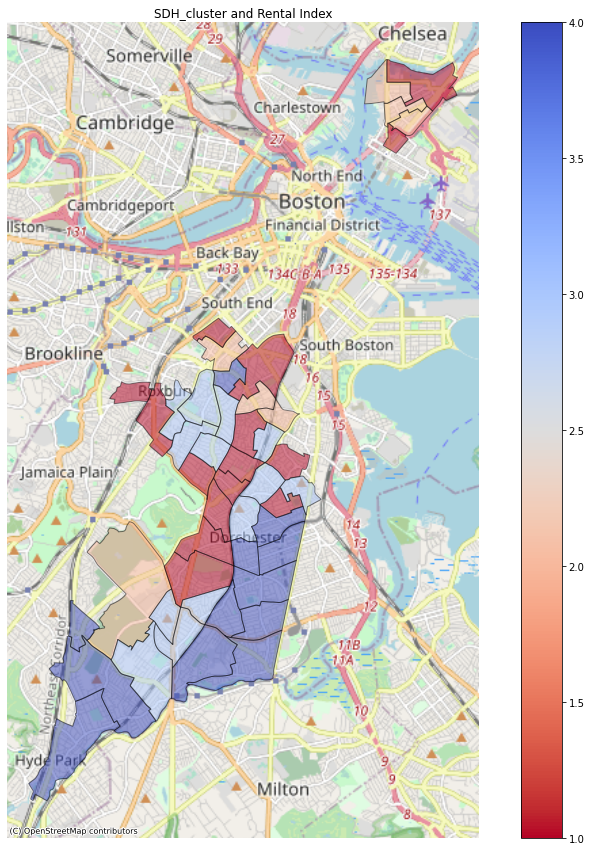

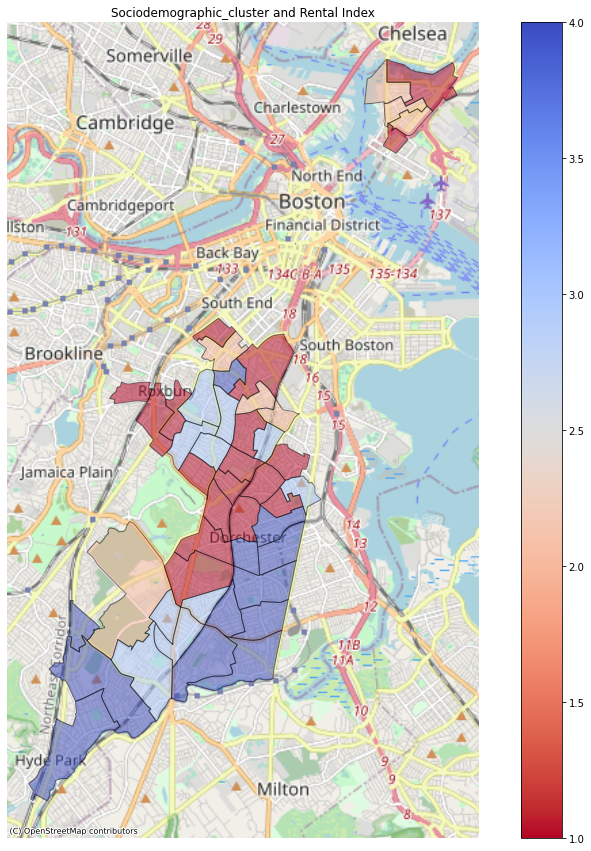

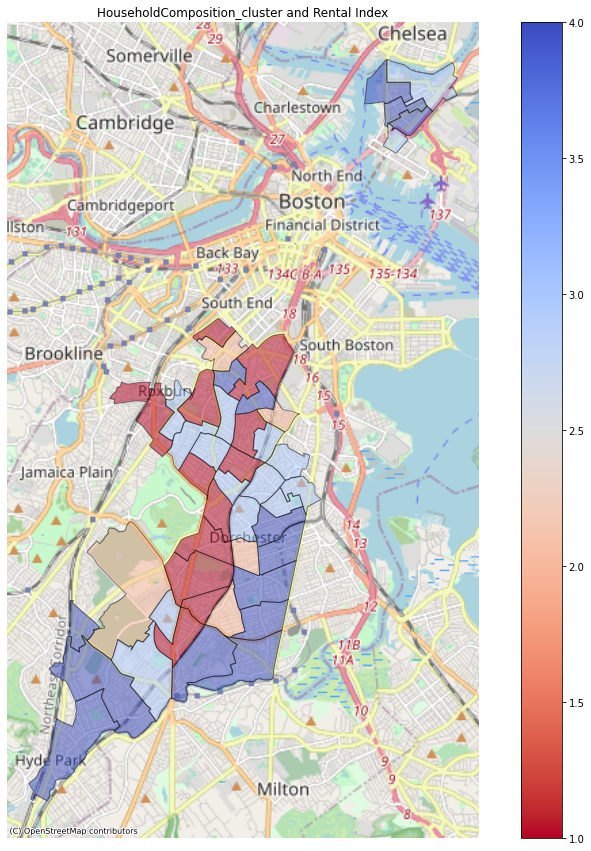

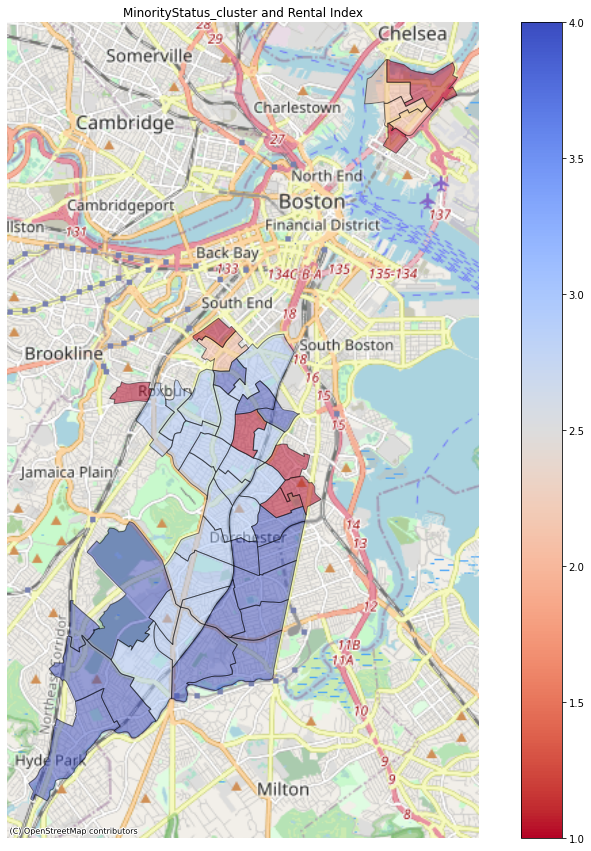

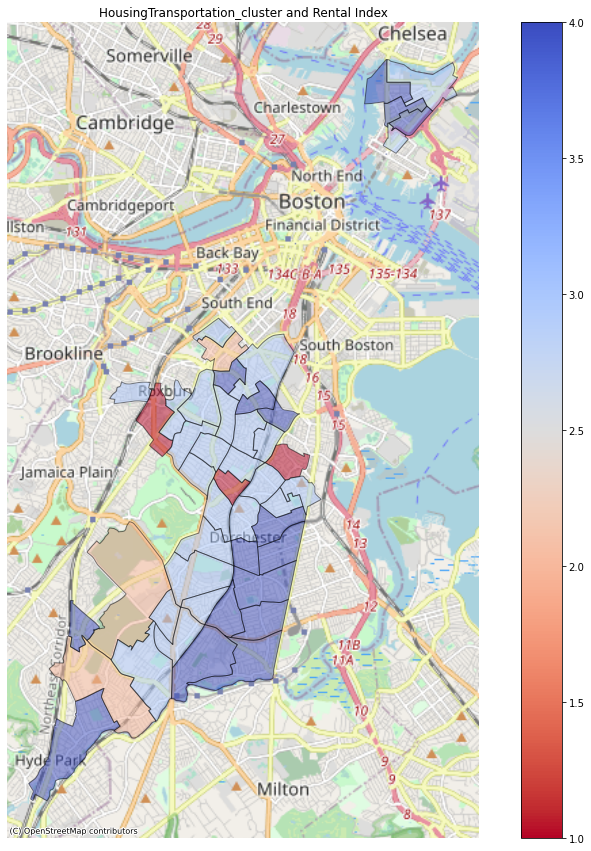

In [ ]:
#1 = (HH), 2 = (HL), 3 = (LH), 4 = (LL) where HH = High SVI, High Redlining, LH = Low SVI, High Redline

import contextily as ctx

cluster_list = ['SDH_cluster','Sociodemographic_cluster','HouseholdComposition_cluster','MinorityStatus_cluster','HousingTransportation_cluster']
for i in cluster_list:
    ax = minority_sdh_boston.to_crs('EPSG:3857').plot(column=i,figsize=(15, 15), alpha=0.5, edgecolor='k', cmap = "coolwarm_r",legend=True, vmin=1, vmax=4)
    ctx.add_basemap(ax, zoom=12, source=ctx.providers.OpenStreetMap.Mapnik)
    ax.set_title('{} and Rental Index'.format(i))
    ax.set_axis_off()

<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=c9a4f701-31a5-4164-b3f3-c09cddf1309e' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>